# Home Exam 52002 - 2024-2025

#**Instructions**
* **Fill your ID Here:** [replace the bracketed text with your ID number]
* Work on the assignment and submit your solution *individually*. <br>
No sharing of information on the assignment is allowed between students.


* **Format:** Fill code, text explanations and output (figures, tables ..) in the designated places. <br>For some questions, the code you fill should run in this .ipynb notebook and generate the output automatically after running (e.g. in `google colab`). <br>For the Unix part you will need to run commands in other environments (Ubuntu) - in this case, just copy the commands and the relevant outputs in the designated text blocks.
Rename the solution file to 'HomeExam_52002_2045_25_[ID].ipynb' where [ID] should be replaced by your ID number.
* Submit your filled solution by Febuary 28th 23:59 your solution on moodle.


* **Data:** Some of the questions requires analyzing and manipulating data files. All the files required for the exam are located in the directory:
'/sci/home/orzuk/FinalExamBigData'
in Moriah.
You may copy them to your working directory in Moriah, to your personal computer or any other computing environment you use. You may need to unzip the files before using them.


* **Grading:**
*  There are overall $11$ questions in this home exam. Each question is worth $9$ points to your total grade. One additional point will be given for submitting  files with correct formats and file names. * **Note:** Points from your grade may be deducted for submitting wrong/missing parts of files OR if not submitting the complete generated/complied output.
* **Note:** Some parts of the code may take a long time  to run.
 Be patient. However, don't leave everything to run at the last minute but prepare in advance so that your entire solution runs and finishes on time.
* **Note**: Solutions with naive or inefficient implementations may reduce the score

###Submission Guidelines:


By the end of the exercise, please submit the following **four** files:


1. **Networks, Streaming, Unix, and Batch Task Processing:**  
   - Provide your solutions in both `.ipynb` (Jupyter Notebook) and `.html` formats. Submit after running all parts of the `.ipynb` notebook except the unix part , check that the outputs of each question were created and saved. For the unix part, copy the code and results manually to the `.ipynb` notebook.

2. **Spark Section:**  
   - Submit the fully executed Jupyter Notebook (`.ipynb`) with all expected outputs, after running it in the Databricks environment.
   - Include an `.html` export of the executed notebook displaying the outputs.  


Ensure that all submitted files are clearly labeled and display the required outputs where applicable.

* **Good luck!**


# Part 1: Unix

## Q1. Preprocessing using Unix



### a. 
The file `network-review-Oregon.json` contains user reviews of different buisnesses (it is a sample from a full `review-Oregon.json` file).
Use Unix commands to generate a new file called `bipartite_network.txt'
containing a table from the file `network-review-Oregon.json`
The table should contain only the next columns:
`user_id,gmap_id_from,rating` separated by commmas

Finally, show all the rows in which the user-id is `100000837087364476756`


### b. 
Use Unix commands and the file from (a.) to generate a new
`network-table.txt` containing one row for each pair of buisnesses (`gmap_id`) that were reviewed by the same user (`user_id`).  

The table should contain only the next columns:
`gmap_id_from,user_id,rating_from,gmap_id_to,rating_to` separated by commmas

You can split your process into multiple steps, creating intermediate CSV/TXT files and then merging them.

Finally, show all the rows in which the user-id is `100000837087364476756`

**Note:** If two different users rate the same two buisnesses, there should be separate rows for the ratings. In addition, the pair of buisnesses should appear twice in the two possible orders.
For example if user1 rated the two buisnesses as 3,4 and user2 rated them as 4,2, the following lines should be in your output file:
gmap_id1, user1, 3, gmap_id2, 4
gmap_id2, user1, 4, gmap_id1, 3
gmap_id1, user2, 4, gmap_id2, 2
gmap_id2, user2, 2, gmap_id1, 4

## SolQ1

### **Shell Commands ($):**

#### a.

In [ ]:
mkdir Data
touch Data/bipartite_network.txt
echo "user_id,gmap_id,rating" >> Data/bipartite_network.txt
zcat /sci/home/orzuk/BigDataMiningExam/network-review-Oregon.json.gz | jq -r '[.user_id, .gmap_id, .rating] | @csv' >> Data/bipartite_network.txt
grep '"100000837087364476756",' Data/bipartite_network.txt

#### b.

In [ ]:
touch Data/network-table.txt
awk -F, '
NR == 1 { print "gmap_id_from,user_id,rating_from,gmap_id_to,rating_to"; next }  # Print header and skip first line

{
    key = $1 "_" $2  # Create a unique key: "user_id_gmap_id"
    ratings[key] = $3
    user_reviews[$1] = user_reviews[$1] "," $2  # Append business IDs for this user
} 
END {
    for (user in user_reviews) {
        split(user_reviews[user], businesses, ",")  # Convert list to array
        n = length(businesses)
        for (i = 2; i < n; i++) {  # Start at index 2 to skip leading comma
            for (j = i + 1; j <= n; j++) {  # Ensure i ≠ j and avoid duplicates
                key1 = user "_" businesses[i]
                key2 = user "_" businesses[j]

                # Print the pair in both orders
                print businesses[i] "," user "," ratings[key1] "," businesses[j] "," ratings[key2]
                print businesses[j] "," user "," ratings[key2] "," businesses[i] "," ratings[key1]
            }
        }
    }
}' Data/bipartite_network.txt >> Data/network-table.txt

# Verify the user-specific entries
grep '"100000837087364476756",' Data/network-table.txt

In [ ]:
sftp -J nathan.pasder@bava.cs.huji.ac.il nathan.pasder@ftp.rcs.huji.ac.il << EOF
lcd ~/Documents/HUJI/BigDataMining52002/Final/Data
lpwd
get Data/bipartite_network.txt
get Data/network-table.txt
bye
EOF

### **Shell Output ($):**

#### a.

```
"100000837087364476756","0x54950a755cc35d8d:0x92d6d400144b2141",5
"100000837087364476756","0x54c17ff7bcaa7c31:0x2970a958143cc922",4
```

#### b.

```
"0x54950a755cc35d8d:0x92d6d400144b2141","100000837087364476756",5,"0x54c17ff7bcaa7c31:0x2970a958143cc922",4
"0x54c17ff7bcaa7c31:0x2970a958143cc922","100000837087364476756",4,"0x54950a755cc35d8d:0x92d6d400144b2141",5
```

### Explanation & result analysis
**a. Preprocessing:**  
We create a CSV file with headers, extract `user_id`, `gmap_id`, and `rating` from the JSON using `jq`, and filter the rows where our `user_id` is `"100000837087364476756"`.

**b. Network Table:**  
We then use `awk` to group our reviews by our `user_id`, generate all business pairs (in both orders) for each review, and finally filter the resulting table for our specific ID.

Data Results
- **Part a:** We see that our review data includes two businesses, with ratings of 5 and 4.  
- **Part b:** We generate two rows representing the bidirectional pairing of our business reviews, ensuring that both orders of the business pair are included.

## Q2. Batch Task Processing- Moriah

We want to calcaulte the total number of reviews and the average rating for each `gmap_id` of the full review file (`review-Oregon.json`)

Implement the following pipeline for this task:
1. Split the input file into five files, one for each rating from 1 to 5 (e.g., `rating_i.txt`) using unix.
2. For each file, submit a job with python script that calculates how many times each `gmap_id` appears. Save the results in a CSV file (e.g. `rating_i_counts.txt`.)
3. Run a final Python script to:
 - Read all the CSV files.
 - Combine the results.
 - Calculate the average rating of `gmap_id` and the total number of reviews.
 - Use the file `meta-Oregon.json` to map `gmap_id` to the buisness name

Print the top three `gmap_id` values sorted by rating, with ties broken by sorting by the number of reviews (both in descending order).
The output table should be with the next columns:
 `gmap_id`,`name`,`avg_rating`,`total_reviews`.


**Note: Steps 2-3 should be as pipline in single bash file**

**Hint:** Use job dependencies because the tasks need to run in order.
You can use [moriah wiki](https://wiki.rcs.huji.ac.il/hurcs/guides/slurm) to learn more.

**Guidence:** Every user has limited compute power. So first write your script on sample of the data and run on the local machine and only when you think that you code is good run on Moriah.

After completing and running the pipelinee, copy the unix script, python code and the results table in the next chunks.

### Python files (First.py and Second.py):

#### First.py

In [ ]:
import pandas as pd
import sys

def count_gmap_ids(input_file, output_file):
    try:
        # Load CSV file (ensuring proper column names)
        df = pd.read_csv(input_file)
        # Ensure 'gmap_id' column exists
        if "gmap_id" not in df.columns:
            print(f"❌ Error: 'gmap_id' column not found in {input_file}")
            return
        # Count occurrences of gmap_id
        gmap_counts = df["gmap_id"].value_counts().reset_index()
        gmap_counts.columns = ["gmap_id", "count"]
        # Save results to a CSV-formatted TXT file
        gmap_counts.to_csv(output_file, index=False)
        print(f"✅ Completed processing: {input_file} -> {output_file}")
    except Exception as e:
        print(f"❌ Error processing {input_file}: {e}")

if __name__ == '__main__':
    if len(sys.argv) < 3:
        print("Usage: python3 count_gmap.py <input_file> <output_file>")
        sys.exit(1)
    input_file = sys.argv[1]
    output_file = sys.argv[2]
    count_gmap_ids(input_file, output_file)


##### Explanation 'First.py'
We implement a function to count occurrences of each `gmap_id` in a CSV file. We:
- **Load Data:** Use Pandas to read the CSV and ensure the `gmap_id` column exists.
- **Count Frequencies:** Apply `value_counts()` on `gmap_id`, then reset the index and rename columns to `gmap_id` and `count`.
- **Output:** Write the results to a CSV-formatted TXT file.  
This script accepts command-line arguments, providing robust error handling and status messages to verify processing.

#### Second.py

In [ ]:
import pandas as pd
import numpy as np
import json
import sys
import os

def aggregate_reviews(data_dir, meta_file, output_file):
    try:
        # Load metadata to map gmap_id -> business name
        gmap_to_name = {}
        with open(meta_file, 'r', encoding='utf-8') as f:
            for line in f:
                try:
                    item = json.loads(line.strip())  # Read each line as a JSON object
                    gmap_to_name[item["gmap_id"]] = item["name"]
                except json.JSONDecodeError:
                    print(f"⚠️ Skipping malformed JSON line: {line.strip()}")

        # Initialize dataframe
        all_data = pd.DataFrame(columns=["gmap_id", "count", "rating"])

        # Process each rating_i_counts.txt file
        for i in range(1, 6):
            rating_file = os.path.join(data_dir, f"rating_{i}_counts.txt")
            if os.path.exists(rating_file) and os.path.getsize(rating_file) > 0:
                df = pd.read_csv(rating_file)
                df["rating"] = i  # Assign the rating value to each row
                all_data = pd.concat([all_data, df], ignore_index=True)

        # Aggregate: Calculate total reviews & average rating per gmap_id
        grouped = all_data.groupby("gmap_id").agg(
            total_reviews=("count", "sum"),
            avg_rating=("rating", lambda x: np.average(x, weights=all_data.loc[x.index, 'count']))
            ).reset_index()

        # Map business names
        grouped["name"] = grouped["gmap_id"].map(gmap_to_name)

        # Sort: First by avg_rating (desc), then by total_reviews (desc)
        grouped = grouped.sort_values(by=["avg_rating", "total_reviews"], ascending=[False, False])

        # Save results
        grouped.to_csv(output_file, index=False)
        print(f"✅ Final results saved to: {output_file}")

        # Print top 3 businesses
        print("\n🏆 Top 3 Businesses:")
        print(grouped.head(3).to_string(index=False))

    except Exception as e:
        print(f"❌ Error in aggregation: {e}")

if __name__ == '__main__':
    if len(sys.argv) < 4:
        print("Usage: python3 Second.py <data_directory> <meta_file> <output_file>")
        sys.exit(1)

    data_dir = sys.argv[1]
    meta_file = sys.argv[2]
    output_file = sys.argv[3]

    aggregate_reviews(data_dir, meta_file, output_file)

##### Explanation 'Second.py'
This script aggregates review counts and computes weighted average ratings:
- **Metadata Mapping:** Reads each JSON line from the metadata file to build a mapping from `gmap_id` to business names.
- **Data Aggregation:** Iterates through the five `rating_i_counts.txt` files. For each file, we assign a static rating value (1–5) and merge the data into a single DataFrame.
- **Grouped Computations:** Using `groupby("gmap_id")`, we sum the review counts and calculate a weighted average rating (using the review counts as weights).
- **Sorting & Output:** We map business names, then sort by average rating (descending) and by total reviews as a tiebreaker. The final aggregated table is written as a CSV file.

### main_bash.sh

In [ ]:
#!/bin/bash
#SBATCH --job-name=BigDataMiningP1Q2_bigdata_pipeline
#SBATCH --output=bigdata_pipeline.out
#SBATCH --error=bigdata_pipeline.err
#SBATCH --time=2:00:00
#SBATCH --mem=16G
#SBATCH --cpus-per-task=4

DATA_DIR="Data"
mkdir -p "$DATA_DIR"
OrZukData="/sci/home/orzuk/BigDataMiningExam"
REVIEW_FILE="$OrZukData/review-Oregon.json.gz"
META_FILE="$OrZukData/meta-Oregon.json.gz"
STEP_2_PYTHON_SCRIPT="First.py"
STEP_3_PYTHON_SCRIPT="Second.py"
FINAL_OUTPUT="$DATA_DIR/final_results.csv"

wait_for_jobs() {
    local job_ids=($1)  # Convert job IDs to an array
    local step_name=$2
    local start_time=$(date +%s)

    echo -n "⏳ Waiting for $step_name to complete... (00:00:00)"
    
    while true; do
        all_completed=true  # Assume all jobs are done unless proven otherwise
        sleep 1  # Check every 1 second

        for job_id in "${job_ids[@]}"; do
            # Check if the job is still running
            if squeue -j "$job_id" | grep -q "$job_id"; then
                all_completed=false  # At least one job is still running
                break
            fi

            # If job is not in squeue, check its historical status in sacct
            job_status=$(sacct -j "$job_id" --format=State --noheader | awk '{print $1}' | sort | uniq)

            if [[ "$job_status" =~ "FAILED|CANCELLED|TIMEOUT" ]]; then
                echo -e "\n❌ $step_name failed. Job ID: $job_id, Status: $job_status"
                exit 1
            elif [[ "$job_status" == "COMPLETED" ]]; then
                continue  # Job is done, check the next one
            elif [[ -z "$job_status" ]]; then
                echo -e "\n⚠️  Warning: Job ID $job_id not found in SLURM history. Assuming completed."
            else
                all_completed=false  # Job status is unclear, so keep waiting
                break
            fi
        done

        # If all jobs are completed, exit the loop
        if $all_completed; then
            break
        fi

        # Update elapsed time dynamically
        current_time=$(date +%s)
        elapsed=$((current_time - start_time))
        hours=$((elapsed / 3600))
        minutes=$(((elapsed % 3600) / 60))
        seconds=$((elapsed % 60))
        printf "\r⏳ Waiting for $step_name to complete... (%02d:%02d:%02d)" $hours $minutes $seconds
    done

    # Final message
    printf "\r✅ $step_name completed in (%02d:%02d:%02d)\n" $hours $minutes $seconds
}

echo "🚀 Submitting SLURM Jobs for Optimized Pipeline..."

# ===================== STEP 1: SPLIT REVIEWS (PARALLEL JOBS) =====================
echo "📂 Submitting Step 1: Splitting reviews into parallel jobs..."

STEP1_JOB_IDS=()
for i in {1..5}; do
    STEP1_JOB=$(sbatch --parsable <<EOF
#!/bin/bash
#SBATCH --job-name=BigDataMiningP1Q2_split_rating_$i
#SBATCH --output=split_rating_$i.out
#SBATCH --mem=4G
#SBATCH --cpus-per-task=1

output_file="$DATA_DIR/rating_$i.txt"
echo "user_id,rating,gmap_id" > "\$output_file"

zcat "$REVIEW_FILE" | jq --argjson i "$i" -r 'select(.rating == $i) | [.user_id, .rating, .gmap_id] | @csv' >> "\$output_file"

echo "✅ Created \$output_file with \$(wc -l < "\$output_file") lines."
EOF
)
    STEP1_JOB_IDS+=("$STEP1_JOB")
done

echo "📊 Step 1 Jobs Submitted: ${STEP1_JOB_IDS[*]}"

DEPENDENCY_STEP1=$(IFS=,; echo "${STEP1_JOB_IDS[*]}")

# ===================== WAIT FOR STEP 1 TO FINISH =====================
wait_for_jobs "$DEPENDENCY_STEP1" "Step 1 (Splitting Reviews)"

# ===================== STEP 2: COUNT gmap_id (PARALLEL JOBS) =====================
echo "📂 Submitting Step 2: Counting gmap_id occurrences..."

STEP2_JOB_IDS=()
for i in {1..5}; do
    STEP2_JOB=$(sbatch --parsable --dependency=afterok:$DEPENDENCY_STEP1 <<EOF
#!/bin/bash
#SBATCH --job-name=BigDataMiningP1Q2_count_rating_$i
#SBATCH --output=count_rating_$i.out
#SBATCH --mem=4G
#SBATCH --cpus-per-task=1

input_file="$DATA_DIR/rating_$i.txt"
output_file="$DATA_DIR/rating_${i}_counts.txt"

if [ -s "\$input_file" ]; then
    python3 "$STEP_2_PYTHON_SCRIPT" "\$input_file" "\$output_file"

    if [ -s "\$output_file" ]; then
        echo "✅ Created \$output_file with \$(wc -l < "\$output_file") lines."
    else
        echo "❌ Error: Output file \$output_file was not created."
    fi
else
    echo "⚠️ Skipping empty file: \$input_file"
fi
EOF
)
    STEP2_JOB_IDS+=("$STEP2_JOB")
done

echo "📊 Step 2 Jobs Submitted: ${STEP2_JOB_IDS[*]}"

DEPENDENCY_STEP2=$(IFS=,; echo "${STEP2_JOB_IDS[*]}")

# ===================== WAIT FOR STEP 2 TO FINISH =====================
wait_for_jobs "$DEPENDENCY_STEP2" "Step 2 (Counting gmap_id)"

# ===================== STEP 3: AGGREGATE RESULTS =====================
echo "📂 Submitting Step 3: Aggregating final results..."

STEP3_JOB=$(sbatch --parsable --dependency=afterok:$DEPENDENCY_STEP2 <<EOF
#!/bin/bash
#SBATCH --job-name=BigDataMiningP1Q2_aggregate_results
#SBATCH --output=aggregate_results.out
#SBATCH --mem=8G
#SBATCH --cpus-per-task=2

zcat "$META_FILE" | python3 "$STEP_3_PYTHON_SCRIPT" "$DATA_DIR" "/dev/stdin" "$FINAL_OUTPUT"

if [ -s "$FINAL_OUTPUT" ]; then
    echo "✅ Step 3 completed successfully. Final results saved in $FINAL_OUTPUT"
else
    echo "❌ Step 3 failed. No output file generated."
    exit 1
fi
EOF
)

echo "📊 Step 3 Jobs Submitted: $STEP3_JOB"

# ===================== WAIT FOR STEP 3 TO FINISH =====================
wait_for_jobs "$STEP3_JOB" "Step 3 (Aggregation)"

# ===================== PRINT TOP 3 BUSINESSES =====================
if [ -s "$FINAL_OUTPUT" ]; then
    echo "✅ Aggregation complete. Displaying top 3 businesses from $FINAL_OUTPUT"

    echo ""
    echo "🏆 Top 3 Businesses:"
    echo "--------------------------"
    head -n 4 "$FINAL_OUTPUT" | tail -n 3 | column -t -s ","
    echo "--------------------------"
else
    echo "❌ Error: Aggregation failed or output file is empty."
fi

echo "✅ Optimized SLURM Pipeline Completed Successfully."

#### Explanation 'main_bash.sh'
This SLURM-based Bash pipeline orchestrates the batch processing tasks:
- **Step 1 – Splitting:** We split the compressed review file into five files (one per rating) using `zcat` and `jq` within parallel SLURM jobs.
- **Job Synchronization:** A custom `wait_for_jobs` function polls SLURM (via `squeue` and `sacct`) to ensure all splitting jobs complete before proceeding.
- **Step 2 – Counting:** With job dependencies set (using `--dependency=afterok`), we submit parallel jobs to run **First.py** on each split file.
- **Step 3 – Aggregation:** Once counting jobs finish, we launch a final job that pipes the uncompressed metadata (using `zcat`) into **Second.py**. The aggregated results are stored in a final CSV file.
- **Output Display:** The script extracts and prints the top three businesses based on the sorted aggregated data.
- **Robust Cluster Integration:** The script uses here-documents (EOF) to embed job scripts within the main script, ensuring that all jobs are defined inline. It also employs environment variables for dynamic path configuration, making it easy to adapt to different cluster environments.


### Cluster setup
Dear Bodek, on your local terminal, run sftp in order to upload/update files, and then re-enter the cluster to start submitting the job and track its live prints using the commands below(change my username):

In [ ]:
# ===================== EXECUTE ON LOCAL TERMINAL TO UPLOAD FILES TO CLUSTER =====================
REMOTE_USER="nathan.pasder"
REMOTE_SFTP_HOST="ftp.rcs.huji.ac.il"
REMOTE_JUMP_HOST="bava.cs.huji.ac.il"
REMOTE_DIR="/sci/home/nathan.pasder"
LOCAL_DIR=~/Documents/HUJI/BigDataMining52002/Final/
OrZukData="/sci/home/orzuk/BigDataMiningExam"


echo "🚀 Uploading new scripts via SFTP..."
sftp -J "$REMOTE_USER@$REMOTE_JUMP_HOST" "$REMOTE_USER@$REMOTE_SFTP_HOST" << EOF
    lcd "$LOCAL_DIR"
    cd "$REMOTE_DIR"

    # Ensure Data directory exists
    mkdir Data 2>/dev/null  # Won't fail if it already exists

    # Upload new scripts (will overwrite existing files)
    lcd "$LOCAL_DIR"
    put main_bash.sh
    put First.py
    put Second.py

    echo "✅ Upload complete."
    bye
EOF

# ===================== EXECUTE JOB FROM LOCAL TERMINAL =====================
ssh -J "$REMOTE_USER@$REMOTE_JUMP_HOST" "$REMOTE_USER@moriah-gw.cs.huji.ac.il"
ls
sbatch main_bash.sh
squeue -u $USER
tail -f bigdata_pipeline.out

# ===================== EXECUTE ON LOCAL TERMINAL TO DOWNLOAD OUTPUT FILES FROM THE CLUSTER =====================
OrZukData="/sci/home/orzuk/BigDataMiningExam"
sftp -J "$REMOTE_USER@$REMOTE_JUMP_HOST" "$REMOTE_USER@$REMOTE_SFTP_HOST" << EOF
    lcd "$LOCAL_DIR/Data"
    cd "$REMOTE_DIR"
    # Ensure Data directory exists
    get Data/*
    get "$OrZukData/review-Oregon.json.gz"
    get "$OrZukData/network-review-Oregon.json.gz"
    get "$OrZukData/meta-Oregon.json.gz"
    bye
EOF
ls -lh
cd ~/Documents/HUJI/BigDataMining52002/Final/Data
gunzip *.json.gz

#### Explanation 'Cluster setup'
We manage file transfers and job submissions via a two-step process:
- **Uploading:** We use SFTP with a jump host to securely upload our updated scripts (i.e., `main_bash.sh`, `First.py`, and `Second.py`) to the cluster.
- **Job Execution:** After logging in via SSH through the jump host, we submit our pipeline with `sbatch`, monitor job status using `squeue`, and review log outputs with `tail -f`.
- **Downloading:** Once processing is complete, we retrieve the output files back to our local machine via SFTP, ensuring our local workspace is updated with the latest results.

### Output

In [ ]:
nathan.pasder@moriah-gw-02:~ $ ls 
Data/  First.py  main_bash.sh  Second.py*
nathan.pasder@moriah-gw-02:~ $ sbatch main_bash.sh

Submitted batch job 29970759
nathan.pasder@moriah-gw-02:~ $ squeue -u $USER

             JOBID PARTITION     NAME     USER ST       TIME  NODES NODELIST(REASON)
          29970759   glacier BigDataM nathan.p  R       0:03      1 glacier-08
          29970764 glacier,p BigDataM nathan.p PD       0:00      1 (None)
          29970763 glacier,p BigDataM nathan.p PD       0:00      1 (None)
          29970762 glacier,p BigDataM nathan.p PD       0:00      1 (None)
          29970761 glacier,p BigDataM nathan.p PD       0:00      1 (None)
          29970760 glacier,p BigDataM nathan.p PD       0:00      1 (None)
nathan.pasder@moriah-gw-02:~ $ tail -f bigdata_pipeline.out

🚀 Submitting SLURM Jobs for Optimized Pipeline...
📂 Submitting Step 1: Splitting reviews into parallel jobs...
📊 Step 1 Jobs Submitted: 29970760 29970761 29970762 29970763 29970764
✅ Step 1 (Splitting Reviews) completed in (00:01:52)... (00:01:52)
📂 Submitting Step 2: Counting gmap_id occurrences...
📊 Step 2 Jobs Submitted: 29970765 29970766 29970767 29970768 29970769
✅ Step 2 (Counting gmap_id) completed in (00:00:02)... (00:00:02)
📂 Submitting Step 3: Aggregating final results...
📊 Step 3 Jobs Submitted: 29970770
✅ Step 3 (Aggregation) completed in (00:00:16)... (00:00:16)
✅ Aggregation complete. Displaying top 3 businesses from Data/final_results.csv

🏆 Top 3 Businesses:
--------------------------
0x87b21fedbf7f4f5b:0xa379fce9177a3dc6  372  5.0  Tip Top K9 Dog Training              
0x5495a269266d6e8b:0x8c2044a8b62bc3cb  348  5.0  Peniche and Associates               
0x89aec3802de3cd09:0x1bd2662c90a6a12c  268  5.0  "Pirate and Pixie Dust Destinations   LLC"
--------------------------
✅ Optimized SLURM Pipeline Completed Successfully.
^C

#### Explanation & result analysis
Our final output is a CSV table containing the columns: `gmap_id`, `name`, `avg_rating`, and `total_reviews`. The aggregated results show that:
- Each `gmap_id` is assigned a weighted average rating calculated from the individual rating counts.
- The top three entries, sorted by descending average rating (and then total review count), all achieved an average rating of 5.0 with review counts of 372, 348, and 268, respectively.  
This precise technical pipeline efficiently processes and aggregates the review data, mapping it to business names and ranking them according to both quality (average rating) and popularity (total reviews).


# Part 2 : Streaming Algorithms

## Q1. Streaming Sampling Algorithm
- Write python function that reads the `review-Oregon.json` file **line-by-line**, i,e, **one line at a time** (see code template below).  Your code should implement  
online sampling of 1000 random users and all of their ratings. That is, you should initialize and update a data structue such that
after each value of $n$ lines that were processed that correspond to $k \leq n$ distinct users, it should hold that your data structure stores the identity of $min(k, 1000)$ users chosen uniformly at random from the first $k$ users (without replacement), and will also store **all** lines corresponding to these users

- After finishing to process all lines in the file, compute 'ave_rating' for all buisnesses using this sample of $1000$ users, and make a scatter plot of this `ave_rating` vs. the `ave_rating` from Unix Q2 using all users. Decsribe the results

**Notes:** You should never store the entire file in memory. After reading each line, if you decide to not include the corresponding user in your sample you should throw it away and never use it again.
Exclude from the scatter plot buisnesses that were not reviewed by any of the 1000 users in your sample.

### Q1_Sol

📂 Total lines in file: 11012170
⌛ Processed 11012000/11012170 lines (100.00%), Distinct Users: 2764026/11012000 (25.10%), Sampled Users: 1000/1000 (100.00%)
✅ Finished processing for sampling.
Total distinct users encountered: 2764082
Final sample size: 1000
Total collected reviews: 55314

📊 Sampled Reviews DataFrame Info:
Rows: 55314, Columns: 3
--------------------------------------------------

📊 Sample Average Ratings DataFrame Info:
Rows: 22939, Columns: 2
--------------------------------------------------

📊 Overall Business Ratings DataFrame Info:
Rows: 93006, Columns: 2
--------------------------------------------------

📊 Merged Ratings for Comparison DataFrame Info:
Rows: 22939, Columns: 3
--------------------------------------------------


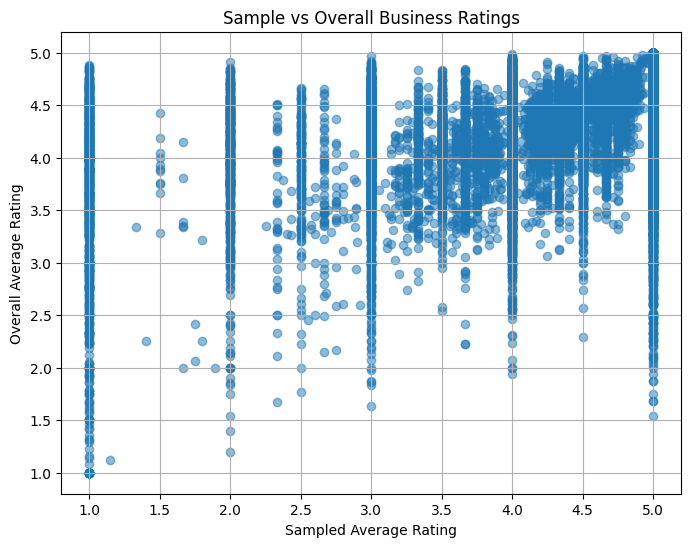

In [56]:
import json
import random
import sys
import matplotlib.pyplot as plt
import pandas as pd

# Constants
FILE_PATH = 'Data/review-Oregon.json'
CSV_PATH = 'Data/final_results.csv'
RESERVOIR_SIZE = 1000  # Target sample size
PROGRESS_INTERVAL = 1000  # Frequency of progress updates


def print_df_info(df, name):
    """Prints basic information about a DataFrame."""
    print(f"\n📊 {name} DataFrame Info:")
    df.head(5)
    print(f"Rows: {df.shape[0]}, Columns: {df.shape[1]}")
    print("-" * 50)


def stream_sampling(file_path, reservoir_size, progress_interval):
    """Performs reservoir sampling of 1000 unique users and stores their reviews in a DataFrame."""
    data = []  # List to collect valid reviews
    reservoir_users = set()  # Track sampled users
    distinct_users = set()  # Track all distinct users
    line_count = 0
    total_lines = sum(1 for _ in open(file_path, 'r'))  # Get total lines in file
    
    print(f"📂 Total lines in file: {total_lines}")
    
    with open(file_path, 'r') as f:
        for line in f:
            line_count += 1
            try:
                review = json.loads(line)
            except json.JSONDecodeError:
                continue  # Skip malformed lines

            user_id = review.get('user_id')
            biz_id = review.get('gmap_id')
            rating = review.get('rating')
            if not user_id or not biz_id or rating is None:
                continue  # Skip invalid entries

            distinct_users.add(user_id)
            
            if user_id in reservoir_users:
                data.append((user_id, biz_id, rating))
            else:
                if len(reservoir_users) < reservoir_size:
                    reservoir_users.add(user_id)
                    data.append((user_id, biz_id, rating))
                else:
                    r = random.randint(0, len(distinct_users) - 1)
                    if r < reservoir_size:
                        removed_user = random.choice(list(reservoir_users))
                        reservoir_users.remove(removed_user)
                        reservoir_users.add(user_id)
                        data.append((user_id, biz_id, rating))
            
            # Dynamic progress update
            if line_count % progress_interval == 0:
                distinct_users_pct = (len(distinct_users) / line_count) * 100 if line_count > 0 else 0
                lines_pct = (line_count / total_lines) * 100
                sampled_users_pct = (len(reservoir_users) / RESERVOIR_SIZE) * 100
                
                sys.stdout.write(f"\r⌛ Processed {line_count}/{total_lines} lines ({lines_pct:.2f}%), "
                                 f"Distinct Users: {len(distinct_users)}/{line_count} ({distinct_users_pct:.2f}%), "
                                 f"Sampled Users: {len(reservoir_users)}/{RESERVOIR_SIZE} ({sampled_users_pct:.2f}%)")
                sys.stdout.flush()
    
    print("\n✅ Finished processing for sampling.")
    print(f"Total distinct users encountered: {len(distinct_users)}")
    print(f"Final sample size: {len(reservoir_users)}")
    print(f"Total collected reviews: {len(data)}")
    
    distinct_users_df = pd.DataFrame(list(distinct_users), columns=['user_id'])
    reservoir_users_df = pd.DataFrame(list(reservoir_users), columns=['user_id'])
    data_df = pd.DataFrame(data, columns=['user_id', 'gmap_id', 'rating'])
    print_df_info(data_df, "Sampled Reviews")

    return data_df


def compute_sample_avg_ratings(df):
    """Computes average ratings for businesses from the sampled users."""
    avg_df = df.groupby('gmap_id')['rating'].mean().reset_index().rename(columns={'rating': 'sample_avg_rating'})
    print_df_info(avg_df, "Sample Average Ratings")
    return avg_df


def load_overall_business_avg(csv_path):
    """Loads overall business average ratings from CSV as a DataFrame."""
    df = pd.read_csv(csv_path)[['gmap_id', 'avg_rating']]
    print_df_info(df, "Overall Business Ratings")
    return df


def plot_comparison(sample_df, overall_df):
    """Creates a scatter plot comparing sample vs overall business ratings."""
    merged_df = sample_df.merge(overall_df, on='gmap_id', how='inner')
    print_df_info(merged_df, "Merged Ratings for Comparison")
    
    plt.figure(figsize=(8, 6))
    plt.scatter(merged_df['sample_avg_rating'], merged_df['avg_rating'], alpha=0.5)
    plt.xlabel('Sampled Average Rating')
    plt.ylabel('Overall Average Rating')
    plt.title('Sample vs Overall Business Ratings')
    plt.grid(True)
    plt.show()



def main():
    """Main function to execute streaming sampling and comparison plot using DataFrames."""
    sample_df = stream_sampling(FILE_PATH, RESERVOIR_SIZE, PROGRESS_INTERVAL)
    sample_avg_ratings = compute_sample_avg_ratings(sample_df)
    overall_avg_ratings = load_overall_business_avg(CSV_PATH)
    plot_comparison(sample_avg_ratings, overall_avg_ratings)

if __name__ == "__main__":
    main()

##### Explanation & result analysis

This code uses **incremental reservoir sampling** to select a **uniform random subset** of exactly **1,000 distinct users** from a massive stream of reviews without loading the entire dataset into memory. Each JSON line is **parsed on the fly** for `user_id`, `gmap_id`, and `rating`. If the user is already in the reservoir, we simply store their review. Otherwise, we either add the user if the reservoir is under capacity or apply a **probabilistic replacement** step to ensure all users have an equal chance of being sampled. This approach maintains a **low memory footprint** while capturing a **representative cross-section** of user ratings.

After streaming through $\sim11$ million lines and discovering $\sim2.76$ million unique users, we end up with 1,000 sampled users who collectively contributed about 55k reviews. We **aggregate** these reviews to compute **sample-based average ratings** for 22k businesses and then **merge** these with the **overall average ratings** from the full dataset. In the scatter plot, we observe a **positive correlation** between the sample-based and overall averages, indicating that despite the **stochastic nature** of reservoir sampling, the sampled distribution largely reflects the true rating landscape. Some **variability** arises for businesses with fewer sampled reviews, but overall, the method provides a **robust approximation** of the global rating patterns with minimal **computational overhead**.

**Reservoir Coverage:**  From $\sim2.76$ million distinct users, the algorithm samples 1,000, capturing **55k reviews** spanning **22k businesses**.The scatter plot compares **sampled average rating** (x-axis) against the **overall average rating** (y-axis).  

A large cluster appears between ratings of 4.0 and 5.0 on both axes, indicating that the sample-based ratings align well with the global averages for many businesses.  

Some points fall below 3.0 on the overall average axis, reflecting businesses that are less favorably rated in the complete dataset, while the sample sometimes shows different averages—likely due to fewer sampled reviews.

Although the sample is relatively small, the high-level patterns mirror the overall dataset, demonstrating that **reservoir sampling** effectively captures the broader rating trends. Variability is expected for businesses with few sample reviews, but the overall density near higher ratings underscores that the sample aligns well with global user sentiments.

# Part 3: Networks

In [ ]:
! pip install python-louvain
! pip install folium

In [ ]:
import pandas as pd
import networkx as nx
import matplotlib.pyplot as plt
import numpy as np
import community as community_louvain
from geopy.distance import geodesic
import folium
import random
from branca.colormap import LinearColormap

## Q1. Exploratory Data Analysis

### a. 
Read the data file `network-table.txt` you created in the the previous Unix question.  
In addition, read the file *meta-Oregon.json*, which contains additional information about each `gmap_id`, such as category, website, and more.  
Display the first five rows of each dataset and explain what is shown and what does the data represents.

**Note:** If you failed to create the correct `network-table.txt` file in the unix part, you can use for this question the file we supply.

In [57]:
import pandas as pd
import json

NETWORK_TABLE_PATH = 'Data/network-table.txt'

# Read network-table.txt
network_df = pd.read_csv(NETWORK_TABLE_PATH)
print("📊 First five rows of network-table.txt:")
network_df.head()

📊 First five rows of network-table.txt:


,gmap_id_from,user_id,rating_from,gmap_id_to,rating_to
0,0x54c43d32ba265427:0x163b39283c8307c7,105765473316666918624,4,0x54c49cb3a08ecdab:0x424e43babf634dd5,4
1,0x54c49cb3a08ecdab:0x424e43babf634dd5,105765473316666918624,4,0x54c43d32ba265427:0x163b39283c8307c7,4
2,0x54c11e14b45a4339:0x558653a0c0fe6f2a,109056019028012520715,4,0x54bfff9fb04ab4bd:0xdc40f423709d812f,4
3,0x54bfff9fb04ab4bd:0xdc40f423709d812f,109056019028012520715,4,0x54c11e14b45a4339:0x558653a0c0fe6f2a,4
4,0x54c11e14b45a4339:0x558653a0c0fe6f2a,109056019028012520715,4,0x54c11e14b45a4339:0x558653a0c0fe6f2a,4


In [58]:
META_DATA_PATH = 'Data/meta-Oregon.json'
import pandas as pd 
import json

# Read meta-Oregon.json (assuming each line is a JSON object)
meta_data = []
with open(META_DATA_PATH, 'r') as f:
    for line in f:
        try:
            meta_data.append(json.loads(line))
        except json.JSONDecodeError:
            continue  # Skip malformed lines

meta_df = pd.DataFrame(meta_data)
print("📊 First five rows of meta-Oregon.json:")
meta_df.head()


📊 First five rows of meta-Oregon.json:


,name,address,gmap_id,description,latitude,longitude,category,avg_rating,num_of_reviews,price,hours,MISC,state,relative_results,url
0,iPolish Nails Spa,None,0x80dce9997c8d25fd:0xc6c81c1983060cbc,None,45.597767,-127.269699,"[Nail salon, Service establishment]",5.0,1,None,"[[Thursday, 10AM–7PM], [Friday, 10AM–7PM], [Sa...","{'Payments': ['Debit cards', 'Credit cards']}",Open ⋅ Closes 7PM,"[0x80dce9aec70a4ee9:0xc7cf24c90e4b537f, 0x80dc...",https://www.google.com/maps/place//data=!4m2!3...
1,"Karens Country Confections, LLC",None,0x89d0ba60af135b2f:0xd548538d7a3e2b8,None,45.598021,-127.269639,"[Bakery, Service establishment]",5.0,4,None,"[[Thursday, Closed], [Friday, Closed], [Saturd...",{'Service options': ['Delivery']},Closed ⋅ Opens 9AM Sat,"[0x89d0ac763567481b:0x90e7c3d44df486ce, 0x89d0...",https://www.google.com/maps/place//data=!4m2!3...
2,E & L General Contractors Inc,"E & L General Contractors Inc, 14161 S Redland...",0x549576c32c7ce82d:0x166266dbfadf6660,None,45.360527,-122.575448,[Concrete contractor],5.0,6,None,None,None,None,"[0x54957451d00ee61b:0xe247a7cb0184f2e, 0x54957...",https://www.google.com/maps/place//data=!4m2!3...
3,McDonald Orthodontics,"McDonald Orthodontics, 1855 W Nob Hill St SE #...",0x54bfff5952aad583:0xad7afdc825730614,None,44.922504,-123.043930,[Orthodontist],4.9,198,None,"[[Thursday, 8AM–4:30PM], [Friday, Closed], [Sa...",{'From the business': ['Identifies as veteran-...,Closed ⋅ Opens 8AM,"[0x54bfff5c0ef7b38b:0xa14bec68116fbe4a, 0x54bf...",https://www.google.com/maps/place//data=!4m2!3...
4,Donatello's at Marion Forks,"Donatello's at Marion Forks, 34970 OR-22, Idan...",0x54bf0922053d25ed:0x73bbe9954ead56b2,None,44.615250,-121.948546,[Pizza Takeout],4.5,27,None,"[[Thursday, 11AM–7PM], [Friday, 11AM–7PM], [Sa...","{'Service options': ['Takeout', 'Delivery']}",Temporarily closed,None,https://www.google.com/maps/place//data=!4m2!3...


### b. 
Read the file `network-table.txt` and plot a histogram showing the number of reviews by each user (`user_id`).
Next, plot a histogram showing the number of unique users reviewing each buisness (`gmap_id`).

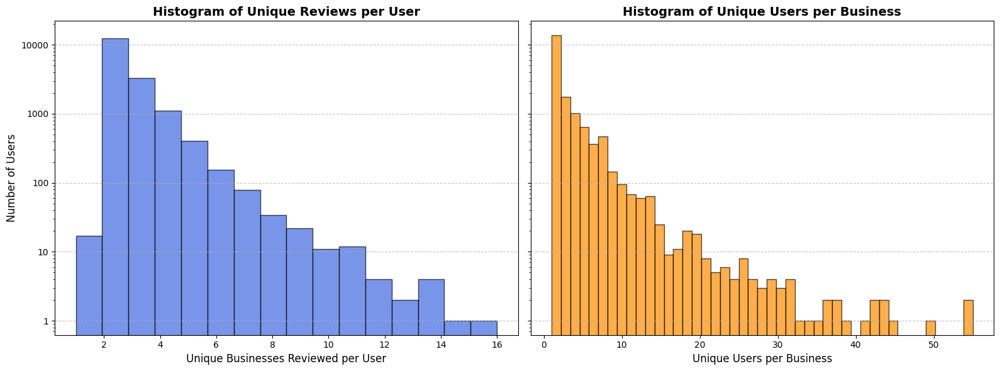

In [59]:
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib.ticker import ScalarFormatter


# Load network table

# Count unique businesses reviewed per user
user_review_counts = network_df[['user_id', 'gmap_id_from']].drop_duplicates().groupby('user_id').size().reset_index()
user_review_counts.columns = ['user_id', 'review_count']

# Count unique users reviewing each business
gmap_review_counts = network_df[['gmap_id_from', 'user_id']].drop_duplicates().groupby('gmap_id_from').size().reset_index()
gmap_review_counts.columns = ['gmap_id', 'user_count']
# Plot side-by-side histograms
fig, axes = plt.subplots(1, 2, figsize=(16, 6), sharey=True, facecolor='white')

# Adjusting bins for better visibility of small values
bins_user = max(10, min(50, len(user_review_counts['review_count'].unique())))
bins_gmap = max(10, min(50, len(gmap_review_counts['user_count'].unique())))

# Histogram of unique reviews per user
axes[0].hist(user_review_counts['review_count'], bins=bins_user, edgecolor='black', alpha=0.7, color='royalblue')
axes[0].set_xlabel('Unique Businesses Reviewed per User', fontsize=12)
axes[0].set_ylabel('Number of Users', fontsize=12)
axes[0].set_title('Histogram of Unique Reviews per User', fontsize=14, fontweight='bold')
axes[0].grid(axis='y', linestyle='--', alpha=0.7)
axes[0].set_yscale('log')  # Adjusting scale to better show small values
axes[1].yaxis.set_major_formatter(ScalarFormatter())

# Histogram of unique users per business
axes[1].hist(gmap_review_counts['user_count'], bins=bins_gmap, edgecolor='black', alpha=0.7, color='darkorange')
axes[1].set_xlabel('Unique Users per Business', fontsize=12)
axes[1].set_title('Histogram of Unique Users per Business', fontsize=14, fontweight='bold')
axes[1].grid(axis='y', linestyle='--', alpha=0.7)
axes[1].set_yscale('log')  # Adjusting scale to better show small values
axes[1].yaxis.set_major_formatter(ScalarFormatter())
plt.tight_layout()
plt.show()

#### Explanation & result analysis

**Reading the Data**  
   - We load `network-table.txt` into a DataFrame (`network_df`) to get pairwise relationships between businesses (`gmap_id_from`, `gmap_id_to`) and the users (`user_id`) who reviewed them.  
   - We parse `meta-Oregon.json` line by line, converting each JSON record into a dictionary and collecting them in `meta_df`. This metadata contains additional attributes such as name, address, and category for each `gmap_id`.

**Computing Counts**  
   - **`user_review_counts`:** We group by `user_id` and count the unique businesses reviewed by each user, revealing how many distinct businesses each user has rated.  
   - **`gmap_review_counts`:** We group by `gmap_id_from` and count the unique users who reviewed each business, indicating each business’s reviewer base.

**Plotting Histograms**  
   - We create two side-by-side histograms: one for `user_review_counts` (the number of businesses per user) and one for `gmap_review_counts` (the number of users per business).  
   - We apply a **log-scale** on the y-axis to better visualize the broad range of frequencies, label axes, and add grid lines for clarity.

**User Reviews per Business (Left Plot):**  
Shows a **right-skewed distribution** where most users review only a few businesses, while a smaller group covers many.  

**Unique Users per Business (Right Plot):**  
Also **right-skewed**: many businesses attract only a few users, whereas a handful are much more popular.  

**Interpretation:**  
Both plots confirm the typical “long-tail” pattern in user-generated reviews, with heavy clustering at low counts and a smaller fraction of high-activity cases.

### c.
  - Display the distribution of buisness categories using the `meta-Oregon` file. For each buisness having multiple categories use only the first `category`. Show only the top 30 categories having the largest number of buisnesses. Highlight all the restaurant cateories  in a different color.  
  - Choose 4 of the top 30 categories and show for each one of them the distribution of `avg_rating` (from the `meta-Oregon` file) for this cateroy.

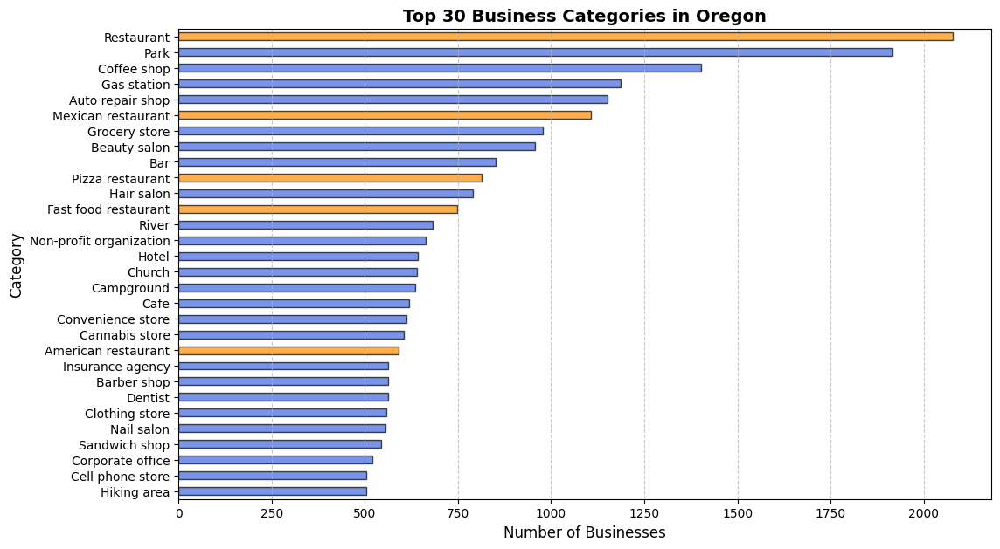

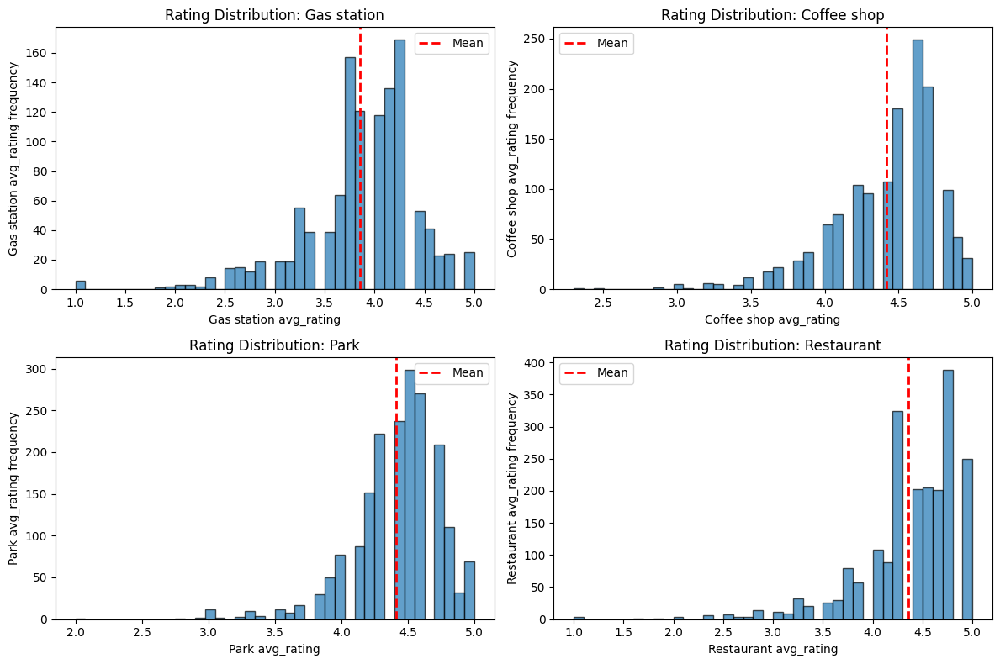

In [60]:
import matplotlib.pyplot as plt
# Extract the first category for each business
meta_df['category'] = meta_df['category'].apply(lambda x: x[0] if isinstance(x, list) and len(x) > 0 else None)

# Count businesses per category
category_counts = meta_df['category'].value_counts().head(30).sort_values()

# Highlight only categories that contain 'restaurant' in any form
colors = ['darkorange' if 'restaurant' in rest.lower() else 'royalblue' for rest in category_counts.index]

plt.figure(figsize=(12, 7), facecolor='white')
category_counts.sort_values().plot(kind='barh', color=colors, edgecolor='black', alpha=0.7)
plt.xlabel('Number of Businesses', fontsize=12)
plt.ylabel('Category', fontsize=12)
plt.title('Top 30 Business Categories in Oregon', fontsize=14, fontweight='bold')
plt.grid(axis='x', linestyle='--', alpha=0.7)
plt.show()

# Select the highest 4 categories
top_ranked_labels = category_counts.index[-4:]

# Plot settings
plt.figure(figsize=(12, 8))
plot_index = 1
for label in top_ranked_labels:
    rating_values = meta_df[meta_df['category'] == label]['avg_rating'].dropna()  # Drop NaNs
    # Create subplot
    plt.subplot(2, 2, plot_index)
    plot_index += 1
    # Histogram
    plt.hist(rating_values, bins=40, edgecolor='black', alpha=0.7)
    # Mean line
    plt.axvline(x=rating_values.mean(), linestyle="dashed", linewidth=2, label='Mean', color='red')

    # Labels and title
    plt.xlabel(f"{label} {meta_df['avg_rating'].name}")
    plt.ylabel(f"{label} {meta_df['avg_rating'].name} frequency")
    plt.title(f"Rating Distribution: {label}")
    plt.legend()

plt.tight_layout()
plt.show()


#### Explanation & result analysis

**Category Extraction & Counting**  
   - We replace each business’s original category list with only its **first** entry, ensuring a single category per business.  
   - We then compute `value_counts()` for these categories, select the top 30, and sort them.

**Bar Chart**  
   - We color each bar orange if its category name contains the string `'restaurant'` (case-insensitive), otherwise blue.  
   - The horizontal bar chart shows how many businesses fall into each of these top 30 categories.

**Rating Distributions**  
   - We pick the top four categories by business count.  
   - For each chosen category, we filter out `NaN` ratings, then create a histogram of its `avg_rating`.  
   - A dashed vertical line indicates the **mean** rating for that category.

**Top Categories:**  
  The bar chart reveals that **Restaurant** is the most frequent category, followed by **Park**, **Coffee shop**, **Gas station**, and so on.  

**Highlighting “Restaurant”:**  
  All categories containing “restaurant” are shown in a different color to emphasize their prevalence.  

**Rating Histograms:**  
  The four most frequent categories (e.g., Gas station, Coffee shop, Park, Restaurant) exhibit slightly different rating distributions. Most businesses cluster around high ratings (4.0–5.0), but each category shows its own spread, with mean ratings marked by the dashed lines.

### d. 
Finally, filter the  the `meta-Oregon` file to include only buisnesses with more than 100 reviews. Use `Folium` to create a map showing the buisnesses with more than 100 reviews as circles, color them by the `avg_rating` between red to green and make their size proportional to the number of reviews (use `radius` = `num_reviews` / 1000).
Using all of these, describe the data and explain its meaning

In [61]:
import pandas as pd
import folium
# Filter the data to include only businesses with more than 100 reviews
filtered_df = meta_df[meta_df['num_of_reviews'] > 100]

# Remove duplicates based on 'gmap_id', keeping only the first occurrence
meta_df_unique = meta_df.drop_duplicates(subset='gmap_id', keep='first')

# Filter the data to include only businesses with more than 100 reviews
filtered_df = meta_df_unique[meta_df_unique['num_of_reviews'] > 100]

# Create the map centered around Oregon (or a suitable central location in the dataset)
m = folium.Map(location=[45.5236, -122.6750], zoom_start=7)  # Centering map on Portland, Oregon

# Add circles to the map based on the filtered data
for _, row in filtered_df.iterrows():
    # Calculate radius based on the number of reviews (num_reviews / 1000)
    radius = row['num_of_reviews'] / 1000
    # Color the circle by avg_rating between red (low) and green (high)
    color = f"#{int((1 - row['avg_rating'] / 5) * 255):02x}{int((row['avg_rating'] / 5) * 255):02x}00"  # Red to green
    
    # Add a circle marker
    folium.CircleMarker(
        location=[row['latitude'], row['longitude']],
        radius=radius,
        color=color,
        fill=True,
        fill_color=color,
        fill_opacity=0.6,
        popup=f"<strong>{row['name']}</strong><br>Rating: {row['avg_rating']}<br>Reviews: {row['num_of_reviews']}",
    ).add_to(m)

# Save and display the map
m

#### Explanation & result analysis

**Data Filtering & Cleanup**  
   We start by loading the `meta_df` DataFrame and removing duplicates based on `gmap_id`. We then filter for businesses having **more than 100 reviews**, reducing the dataset to a set of higher-traffic businesses.

**Folium Map Construction**  
   - We initialize a Folium map centered on **Portland, Oregon**.  
   - For each filtered business, we compute a **marker radius** as `num_of_reviews / 1000`, ensuring that businesses with more reviews appear as larger circles.  
   - The circle **color** transitions from **red** (low rating) to **green** (high rating), calculated by mapping the business’s `avg_rating` (1–5) to a color hex code.  
   - Each marker’s popup shows the **business name**, **average rating**, and **number of reviews**.

**Map Visualization**
- **High-Review Businesses:**  
  By focusing on locations with **>100 reviews**, we highlight **popular** or **well-known** establishments across Oregon.  
- **Visual Distribution:**  
  Larger circles cluster in more populated or tourist-heavy areas, suggesting higher foot traffic and thus more reviews.  
- **Color Gradients:**  
  Redder markers often indicate lower-rated businesses, whereas greener markers represent higher-rated spots. Most businesses appear to lean toward greener hues, suggesting generally positive feedback.  
- **Overall Meaning:**  
  This map visualization reveals **where** and **how** frequently businesses are reviewed, with size indicating popularity (number of reviews) and color reflecting overall satisfaction (average rating).

## Q2. Community Detection - The Louvain Algorithm
- Explain the Louvain algorithm in words, provide an example with at least 6 nodes, display it on a plot, and mark the communities that are formed in the example according to the algorithm (you can use the `community_louvain` implementation).

-  Make one change in the divison to communities (move at least one node from one community to another) and show that the resulting division is sub-optimal by comparing the cost function of the two communities. Write explicitly the formulas that you use.

### Explaining the Louvain algorithm in words

The Louvain method is a popular algorithm for community detection in networks. Its goal is to partition the graph into communities (clusters) by maximizing a measure called **modularity**, which quantifies how well the network is divided into groups with dense internal connections and sparser connections between groups. The algorithm works in two main phases:
1. Each node starts in its own community. The algorithm then iteratively considers moving each node to the community of one of its neighbors, choosing the move that results in the highest positive gain in modularity. This step is repeated until no further improvements can be found.

2. Once no individual move can improve modularity, each community is treated as a single node, and a new weighted network is constructed where the weights represent the sum of the edges between communities. The local optimization step is then repeated on this new network. These phases are repeated iteratively until the modularity cannot be increased further.

This hierarchical and greedy approach efficiently reveals community structures in large networks.

### providing an example with at least 6 nodes

In [62]:
import networkx as nx
import matplotlib.pyplot as plt
import pandas as pd
import community.community_louvain as community_louvain # Ensure the package "python-louvain" is installed

def create_complex_graph(add_extra_edge=False):
    """
    Create a graph with 24 nodes split into 4 communities.
    Each community is a complete subgraph.
    
    Communities:
      - Community 1: Nodes 1 to 6
      - Community 2: Nodes 7 to 12
      - Community 3: Nodes 13 to 18
      - Community 4: Nodes 19 to 24
      
    Fixed inter-community edges connect:
      - Node 6 and Node 7 (C1-C2)
      - Node 12 and Node 13 (C2-C3)
      - Node 18 and Node 19 (C3-C4)
    
    Optionally, add an extra edge between Node 4 (C1) and Node 20 (C4)
    to test the impact on modularity.
    """
    G = nx.Graph()
    
    # Define communities
    communities = {
        1: list(range(1, 7)),
        2: list(range(7, 13)),
        3: list(range(13, 19)),
        4: list(range(19, 25))
    }
    
    # Add intra-community edges (complete graphs)
    for comm, nodes in communities.items():
        for i in nodes:
            for j in nodes:
                if i < j:
                    G.add_edge(i, j)
    
    # Add fixed inter-community edges
    G.add_edge(6, 7)    # Between Community 1 and 2
    G.add_edge(12, 13)  # Between Community 2 and 3
    G.add_edge(18, 19)  # Between Community 3 and 4
    
    # Optionally add an extra edge for increased inter-community connectivity
    if add_extra_edge:
        G.add_edge(4, 20)  # Extra edge connecting Community 1 and 4
    
    # Create a summary DataFrame of node degrees
    degree_data = {"Node": [], "Degree": []}
    for node, degree in G.degree():
        degree_data["Node"].append(node)
        degree_data["Degree"].append(degree)
    df_degrees = pd.DataFrame(degree_data).set_index("Node")
    
    # Summary information
    summary_info = {
        "Total Nodes": [G.number_of_nodes()],
        "Total Edges": [G.number_of_edges()],
        "Extra Edge Added": [add_extra_edge]
    }
    df_summary = pd.DataFrame(summary_info)
    
    print("=== Graph Creation ===")
    print(df_summary)
    print("\nNode Degrees:")
    display(df_degrees)
    
    return G, df_degrees, df_summary

# Create the original graph (without extra edge)
G_original, df_degrees_orig, df_summary_orig = create_complex_graph(add_extra_edge=False)


=== Graph Creation ===
   Total Nodes  Total Edges  Extra Edge Added
0           24           63             False

Node Degrees:


,Degree
Node,
1,5
2,5
3,5
4,5
5,5
6,6
7,6
8,5
9,5


### displaying it on a plot

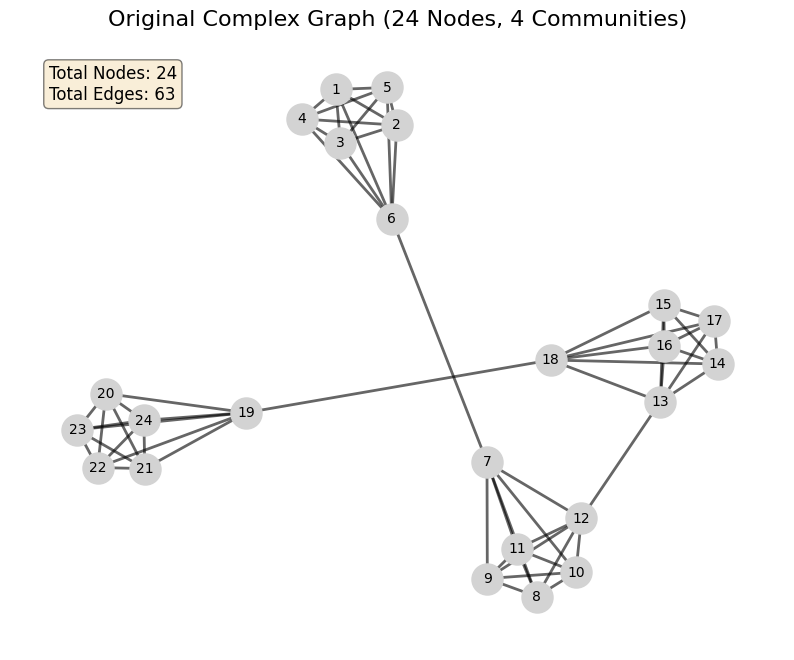

=== Node Layout Positions ===


,x,y
1,-0.250071,0.986750
2,-0.072895,0.858882
3,-0.236219,0.794584
4,-0.349325,0.881022
5,-0.101307,0.994053
6,-0.087362,0.522700
7,0.188867,-0.349965
8,0.333345,-0.832344
9,0.189824,-0.767734
10,0.446857,-0.745022


In [63]:
def display_graph(G, title="Graph Display"):
    """
    Plot the graph with a spring layout.
    Annotate the plot with a title and summary info (total nodes, edges).
    Also print node positions as a DataFrame.
    """
    pos = nx.spring_layout(G, seed=42)
    pos_df = pd.DataFrame(pos).T.rename(columns={0:"x", 1:"y"})
    
    plt.figure(figsize=(10, 8))
    nx.draw_networkx_edges(G, pos, alpha=0.6, width=2)
    nx.draw_networkx_nodes(G, pos, node_size=500, node_color='lightgray')
    nx.draw_networkx_labels(G, pos, font_size=10, font_color='black')
    
    # Annotate the plot with summary text
    textstr = f"Total Nodes: {G.number_of_nodes()}\nTotal Edges: {G.number_of_edges()}"
    plt.gca().text(0.05, 0.95, textstr, transform=plt.gca().transAxes, fontsize=12,
                   verticalalignment='top', bbox=dict(boxstyle='round', facecolor='wheat', alpha=0.5))
    
    plt.title(title, fontsize=16)
    plt.axis('off')
    plt.show()
    
    print("=== Node Layout Positions ===")
    display(pos_df)
    
    return pos, pos_df

# Display the original graph
pos_orig, pos_df_orig = display_graph(G_original, "Original Complex Graph (24 Nodes, 4 Communities)")


### mark the communities that are formed in the example according to the algorithm

=== Louvain Community Detection ===
Overall Modularity: 0.7023

Node-Community Assignment:


,Community
Node,
1,3
2,3
3,3
4,3
5,3
6,3
7,0
8,0
9,0



Community Statistics:


,Nodes,Num_Nodes,Internal_Edges,Sum_of_Degrees
Community,,,,
3,"[1, 2, 3, 4, 5, 6]",6,15,31
0,"[7, 8, 9, 10, 11, 12]",6,15,32
1,"[13, 14, 15, 16, 17, 18]",6,15,32
2,"[19, 20, 21, 22, 23, 24]",6,15,31


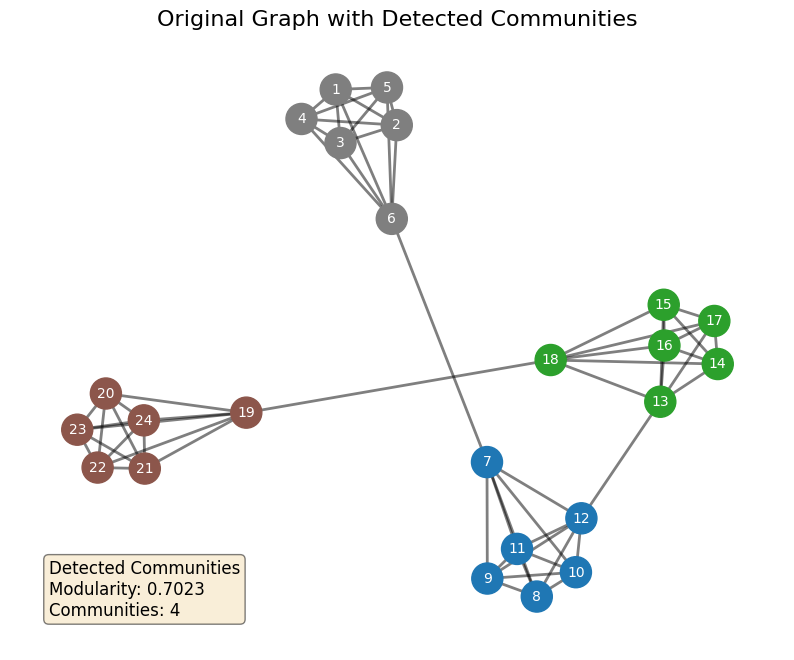

In [64]:
def detect_and_display_communities(G, title="Graph with Detected Communities"):
    """
    Detect communities using the Louvain algorithm.
    Display community assignments, summary statistics in a DataFrame,
    and produce a plot with nodes colored by community.
    """
    # Community detection
    partition = community_louvain.best_partition(G)
    modularity = community_louvain.modularity(partition, G)
    
    # Create a DataFrame for node-community mapping
    df_partition = pd.DataFrame(list(partition.items()), columns=["Node", "Community"]).set_index("Node")
    
    # Gather community-level stats
    comm_stats = []
    communities = {}
    for node, comm in partition.items():
        communities.setdefault(comm, []).append(node)
    
    for comm, nodes in communities.items():
        subgraph = G.subgraph(nodes)
        internal_edges = subgraph.number_of_edges()
        total_degree = sum(dict(G.degree(nodes)).values())
        comm_stats.append({
            "Community": comm,
            "Nodes": nodes,
            "Num_Nodes": len(nodes),
            "Internal_Edges": internal_edges,
            "Sum_of_Degrees": total_degree
        })
    df_comm_stats = pd.DataFrame(comm_stats).set_index("Community")
    
    print("=== Louvain Community Detection ===")
    print("Overall Modularity: {:.4f}".format(modularity))
    print("\nNode-Community Assignment:")
    display(df_partition)
    print("\nCommunity Statistics:")
    display(df_comm_stats)
    
    # Plot with nodes colored by community
    pos = nx.spring_layout(G, seed=42)
    communities_unique = list(set(partition.values()))
    colors = [plt.cm.tab10(float(partition[node]) / len(communities_unique)) for node in G.nodes()]
    
    plt.figure(figsize=(10, 8))
    nx.draw_networkx_edges(G, pos, alpha=0.5, width=2)
    nodes = nx.draw_networkx_nodes(G, pos, node_color=colors, node_size=500)
    nx.draw_networkx_labels(G, pos, font_size=10, font_color='white')
    
    # Annotate the plot with modularity and community info
    textstr = f"Detected Communities\nModularity: {modularity:.4f}\nCommunities: {len(communities_unique)}"
    plt.gca().text(0.05, 0.05, textstr, transform=plt.gca().transAxes, fontsize=12,
                   verticalalignment='bottom', bbox=dict(boxstyle='round', facecolor='wheat', alpha=0.5))
    
    plt.title(title, fontsize=16)
    plt.axis('off')
    plt.show()
    
    return partition, modularity, df_partition, df_comm_stats

# Detect communities for the original graph and display results
partition_orig, mod_orig, df_partition_orig, df_comm_stats_orig = detect_and_display_communities(
    G_original, "Original Graph with Detected Communities"
)


### Suggest change and show the impact using the formulas..  

=== Forced Partition Impact Analysis ===
Original Partition Modularity: 0.7023
Forced Partition Modularity (node 4 moved from community 3 to 0): 0.6192

Comparison of Community Contributions (Affected Communities):


,Original_l,Original_d,Original_Q_contrib,Forced_l,Forced_d,Forced_Q_contrib
Community,,,,,,
3,15,31,0.177564,10,26,0.116150
0,15,32,0.173595,15,37,0.151864


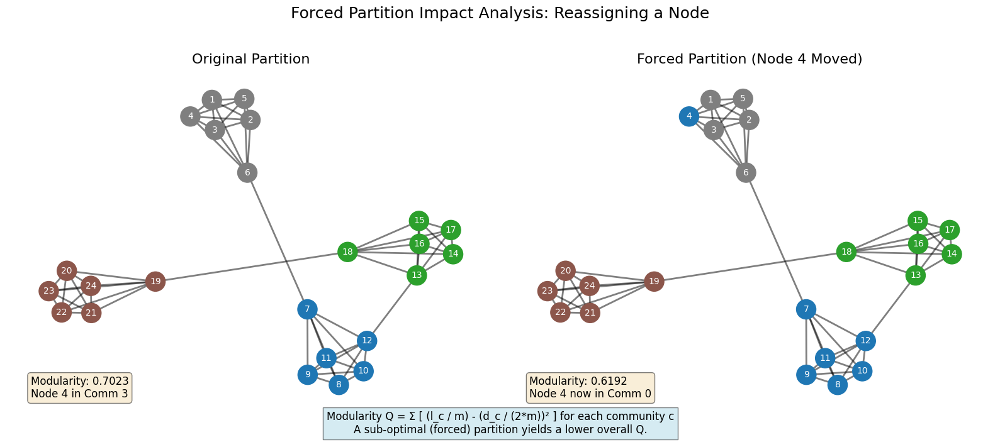

In [65]:
import pandas as pd
import matplotlib.pyplot as plt

def compute_comm_contribution(G, partition, comm):
    """
    Compute the community cost function components.
    
    Returns:
      l_comm: number of internal edges in community
      d_comm: sum of degrees of nodes in community
    """
    nodes = [node for node, c in partition.items() if c == comm]
    subgraph = G.subgraph(nodes)
    l_comm = subgraph.number_of_edges()
    d_comm = sum(dict(G.degree(nodes)).values())
    return l_comm, d_comm

def Q_contribution(l_comm, d_comm, m):
    """
    Compute the modularity contribution for a community using:
      Q_comm = (l_comm / m) - (d_comm / (2*m))**2
    """
    return (l_comm / m) - (d_comm / (2*m))**2

# For demonstration, we use our previously computed G_original and partition_orig.
# Total number of edges in the graph
m = G_original.number_of_edges()

# Choose a node to reassign manually. For example, node 4.
node_to_move = 4
old_comm = partition_orig[node_to_move]
all_comms = set(partition_orig.values())
# Force a new community assignment: choose the smallest community label different from old_comm.
new_comm_candidates = [c for c in all_comms if c != old_comm]
new_comm = min(new_comm_candidates) if new_comm_candidates else old_comm

# Create a forced partition by copying and modifying the original partition.
forced_partition = partition_orig.copy()
forced_partition[node_to_move] = new_comm

# Compute overall modularity for the original and forced partitions.
modularity_original = community_louvain.modularity(partition_orig, G_original)
modularity_forced = community_louvain.modularity(forced_partition, G_original)

print("=== Forced Partition Impact Analysis ===")
print(f"Original Partition Modularity: {modularity_original:.4f}")
print(f"Forced Partition Modularity (node {node_to_move} moved from community {old_comm} to {new_comm}): {modularity_forced:.4f}")

# Compute contributions for the two communities affected.
l_old_orig, d_old_orig = compute_comm_contribution(G_original, partition_orig, old_comm)
l_new_orig, d_new_orig = compute_comm_contribution(G_original, partition_orig, new_comm)
l_old_forced, d_old_forced = compute_comm_contribution(G_original, forced_partition, old_comm)
l_new_forced, d_new_forced = compute_comm_contribution(G_original, forced_partition, new_comm)

Q_old_orig = Q_contribution(l_old_orig, d_old_orig, m)
Q_new_orig = Q_contribution(l_new_orig, d_new_orig, m)
Q_old_forced = Q_contribution(l_old_forced, d_old_forced, m)
Q_new_forced = Q_contribution(l_new_forced, d_new_forced, m)

# Create a DataFrame to compare the contributions for the affected communities.
df_comparison = pd.DataFrame({
    "Community": [old_comm, new_comm],
    "Original_l": [l_old_orig, l_new_orig],
    "Original_d": [d_old_orig, d_new_orig],
    "Original_Q_contrib": [Q_old_orig, Q_new_orig],
    "Forced_l": [l_old_forced, l_new_forced],
    "Forced_d": [d_old_forced, d_new_forced],
    "Forced_Q_contrib": [Q_old_forced, Q_new_forced],
})
df_comparison = df_comparison.set_index("Community")

print("\nComparison of Community Contributions (Affected Communities):")
display(df_comparison)

# Create side-by-side plots for the original and forced partitions.
fig, axs = plt.subplots(1, 2, figsize=(16, 7))

# Plot for the Original Partition.
pos_orig = nx.spring_layout(G_original, seed=42)
colors_orig = [plt.cm.tab10(float(partition_orig[node]) / len(set(partition_orig.values()))) for node in G_original.nodes()]
nx.draw_networkx_edges(G_original, pos_orig, ax=axs[0], alpha=0.5, width=2)
nx.draw_networkx_nodes(G_original, pos_orig, node_color=colors_orig, node_size=500, ax=axs[0])
nx.draw_networkx_labels(G_original, pos_orig, font_size=10, font_color='white', ax=axs[0])
axs[0].set_title("Original Partition", fontsize=16)
axs[0].axis("off")
axs[0].text(0.05, 0.05, f"Modularity: {modularity_original:.4f}\nNode {node_to_move} in Comm {old_comm}",
            transform=axs[0].transAxes, fontsize=12, bbox=dict(boxstyle='round', facecolor='wheat', alpha=0.5))

# Plot for the Forced Partition.
pos_forced = nx.spring_layout(G_original, seed=42)
colors_forced = [plt.cm.tab10(float(forced_partition[node]) / len(set(forced_partition.values()))) for node in G_original.nodes()]
nx.draw_networkx_edges(G_original, pos_forced, ax=axs[1], alpha=0.5, width=2)
nx.draw_networkx_nodes(G_original, pos_forced, node_color=colors_forced, node_size=500, ax=axs[1])
nx.draw_networkx_labels(G_original, pos_forced, font_size=10, font_color='white', ax=axs[1])
axs[1].set_title("Forced Partition (Node 4 Moved)", fontsize=16)
axs[1].axis("off")
axs[1].text(0.05, 0.05, f"Modularity: {modularity_forced:.4f}\nNode {node_to_move} now in Comm {new_comm}",
            transform=axs[1].transAxes, fontsize=12, bbox=dict(boxstyle='round', facecolor='wheat', alpha=0.5))

plt.suptitle("Forced Partition Impact Analysis: Reassigning a Node", fontsize=18)
plt.figtext(0.5, 0.01,
            "Modularity Q = Σ [ (l_c / m) - (d_c / (2*m))² ] for each community c\n"
            "A sub-optimal (forced) partition yields a lower overall Q.",
            ha="center", fontsize=12, bbox=dict(facecolor="lightblue", alpha=0.5))
plt.tight_layout(rect=[0, 0.03, 1, 0.95])
plt.show()


### Mathematically demonstrating the sub-optimality
The formula is:
$$
Q=\frac{1}{2m}\sum_{i=1}^{N}\sum_{j=1}^{N}\Bigl[A_{ij}-\frac{k_i k_j}{2m}\Bigr]\delta(c_i,c_j)
$$
where:  
- $m$ is the total number of edges in the graph.  
- $A_{ij}$ is 1 if there is an edge between nodes $i$ and $j$, and 0 otherwise.  
- $k_i$ and $k_j$ are the degrees of nodes $i$ and $j$, respectively.  
- $\delta(c_i, c_j)$ equals 1 if nodes $i$ and $j$ belong to the same community, and 0 otherwise.
For our analysis, we group the sum by community to obtain the equivalent form:
$$
Q=\sum_{c}\left[\frac{l_c}{m}-\left(\frac{d_c}{2m}\right)^2\right]
$$
where for each community $c$:
- $l_c$ is the number of internal edges (each edge counted once),
- $d_c$ is the sum of degrees of the nodes in $c$.
We have a graph with 24 nodes divided into 4 communities. In our construction, each community is a complete graph on 6 nodes. For each complete graph on 6 nodes, the number of edges is:
$$
l_c = \frac{6 \times 5}{2} = 15.
$$
We also have three fixed inter–community edges:  
- Between Community 0 and Community 1: edge $(6,7)$,  
- Between Community 1 and Community 2: edge $(12,13)$,  
- Between Community 2 and Community 3: edge $(18,19)$.
Then the total number of edges in the graph is:
$$
m = (4 \times 15) + 3 = 60 + 3 = 63.
$$
Assume the Louvain algorithm finds the following optimal assignment:
- Community 0: Nodes 1–6  
- Community 1: Nodes 7–12  
- Community 2: Nodes 13–18  
- Community 3: Nodes 19–24  
Let’s focus on Communities 0 and 1 (the two that will be affected by our forced change).
For Community 0 (nodes 1–6):  
- Within the complete graph, each node (except node 6) has degree 5.  
- Node 6 has an extra connection (the inter–community edge $(6,7)$), so its degree is 6.  
Thus, the sum of degrees is:
$$
d_0 = 5 + 5 + 5 + 5 + 5 + 6 = 31.
$$
For Community 1 (nodes 7–12):  
- In the complete graph, each node has degree 5, except:  
  - Node 7 gets an extra degree (edge $(6,7)$) → degree 6,  
  - Node 12 gets an extra degree (edge $(12,13)$) → degree 6.  
Thus, the sum of degrees is:
$$
d_1 = 6 + 5 + 5 + 5 + 5 + 6 = 32.
$$
Now, the modularity contribution for a community is:
$$
Q_c = \frac{l_c}{m} - \left(\frac{d_c}{2m}\right)^2.
$$
Plugging in the numbers for the optimal partition:
- Community 0:
  $$
  Q_0 = \frac{15}{63} - \left(\frac{31}{126}\right)^2.
  $$

  Numerically,  

  $\frac{15}{63} \approx 0.2381$ and 
  
  $\frac{31}{126} \approx 0.2460$ 
  
  and $(0.2460)^2 \approx 0.0605$.  

  So,  
  $$
  Q_0 \approx 0.2381 - 0.0605 = 0.1776.
  $$

- Community 1:
  $$
  Q_1 = \frac{15}{63} - \left(\frac{32}{126}\right)^2.
  $$
  
  Numerically,

  $\frac{15}{63} \approx 0.2381,$ 

  $\frac{32}{126} \approx 0.2540,$ and  

  $(0.2540)^2 \approx 0.0645.$  
  
  So,  
  $$
  Q_1 \approx 0.2381 - 0.0645 = 0.1736.
  $$
Thus, the combined contribution for Communities 0 and 1 is:
$$
Q_{0+1} \approx 0.1776 + 0.1736 = 0.3512.
$$

Now, suppose we force a change by moving node 4 from Community 0 to Community 1. This “forced” partition alters the values of $l_c$ and $d_c$ for both communities.

Forced Community 0 (after removing node 4):
- New node set: $$\{1,2,3,5,6\}$$.
- For a complete graph on 5 nodes, the number of internal edges is:
  $$
  l_0' = \frac{5 \times 4}{2} = 10.
  $$
- The degrees of the remaining nodes in Community 0:
  - Nodes 1, 2, 3, and 5 each have degree 5, and node 6 still has degree 6.
  So,  
  $$
  d_0' = 5 + 5 + 5 + 5 + 6 = 26.
  $$
Then, the modularity contribution for forced Community 0 becomes:
$$
Q_0' = \frac{10}{63} - \left(\frac{26}{126}\right)^2.
$$

Calculating,  

$\frac{10}{63} \approx 0.1587,$

$\frac{26}{126} \approx 0.2063,$ and

$(0.2063)^2 \approx 0.0426.$  

Thus,  
$$
Q_0' \approx 0.1587 - 0.0426 = 0.1161.
$$

Forced Community 1 (after adding node 4):
- New node set: $\{4,7,8,9,10,11,12\}$.  
- The original complete graph on nodes 7–12 has $l_1 = 15$ edges. Since node 4 did not previously have connections to nodes 7–12, the number of internal edges among nodes 7–12 remains 15; node 4’s addition does not bring extra internal edges with these nodes.
  
  Therefore,  
  $$
  l_1' = 15.
  $$

- The total degree of Community 1 increases by the degree of node 4 in its original community (which is 5):

  $$
  d_1' = 32 + 5 = 37.
  $$

Now, the modularity contribution for forced Community 1 is:

$$
Q_1' = \frac{15}{63} - \left(\frac{37}{126}\right)^2.
$$

Calculating,  

$\frac{15}{63} \approx 0.2381,$

$\frac{37}{126} \approx 0.2937,$ and  

$(0.2937)^2 \approx 0.0862.$

Thus,  
$$
Q_1' \approx 0.2381 - 0.0862 = 0.1519.
$$

The combined contribution from the two communities in the forced partition is:

$$
Q_{0+1}' \approx 0.1161 + 0.1519 = 0.2680.
$$

Demonstrating Sub-Optimality

Comparing the two scenarios:

- **Optimal Partition (Communities 0 and 1):**  
  Combined contribution $$ Q_{0+1} \approx 0.3512 $$

- **Forced Partition (After Moving Node 4):**  
  Combined contribution $$ Q_{0+1}' \approx 0.2680 $$

The difference is:

$$
\Delta Q = Q_{0+1}' - Q_{0+1} \approx 0.2680 - 0.3512 = -0.0832.
$$

A negative $\Delta Q$ means that the forced partition results in a lower overall modularity. In the context of the modularity cost function, a higher $ Q $ indicates a better, more “optimal” community division. Thus, the forced change (moving node 4) degrades the quality of the community structure, making it sub-optimal compared to the original partition.

We have explicitly plugged in the numbers from our example to show:
- What each variable represents ($m$, $A_{ij}$, $k_i$, $\delta(c_i,c_j)$),
- How the optimal partition yields higher modularity, and
- How a forced change (moving node 4) reduces the modularity by $\Delta Q \approx -0.0832$.

This decrease mathematically demonstrates that the original partition (as identified by the Louvain algorithm) is more optimal than the forced, sub-optimal partition.

The graph we constructed consists of 24 nodes grouped into 4 well-defined communities. Each community was created as a complete subgraph, meaning every node within a community is connected to every other node. This structure visually represents tight clusters with strong internal cohesion, which is appealing when you want to demonstrate clear, natural divisions within a network.
We added fixed inter-community edges (e.g., between Community 1 and 2, Community 2 and 3, and Community 3 and 4). These connections simulate real-world scenarios where groups are not completely isolated—they interact at certain points. The graph is both complex and informative, as it balances dense internal connectivity with sparse external links.
In our experiment, we added an extra edge between Node 4 (from Community 1) and Node 20 (from Community 4). This extra link creates additional connectivity between two otherwise distinct communities. When you add such a connection, The extra edge directly connects nodes from communities that were previously only weakly connected. This causes the boundaries between the communities to become blurred.

Modularity is a measure that reflects how well the network is divided into communities. It is calculated based on the difference between the actual edge density within communities and the expected density if edges were placed at random. A higher modularity indicates stronger community structure. In our analysis, the modularity value decreased after adding the extra edge.

A decrease in modularity implies that the community structure is less distinct. In other words, the extra edge has increased the likelihood that nodes from different communities are interacting, thereby reducing the overall "separation" of communities.

The Louvain algorithm efficiently maximizes modularity to detect communities. It quickly adapts to structural changes (like the extra edge) and reveals how even minor adjustments can alter the overall community structure.

## Q3. Network Preliminary Analysis
Represent the data file 'network_data.txt' you've loaded as an **undirected** graph using the `gmap_id_from` and `gmap_id_to` fields:
Make sure that each undorederd (`gmap_id_from` and `gmap_id_to`) appears only once, and remove self loops.

Next, analyze the network:
- First, print the number nodes and edges in the graph.
- Then, plot the degree distribution and explain what the plot reveals.
- Finally, visualize the entire graph and describe what you observe. Use the default layout of `networkx` draw function.

**Note: the plot might take a while to run..**

### First, print the number nodes and edges in the graph.

In [70]:
import pandas as pd
import networkx as nx
import matplotlib.pyplot as plt
from matplotlib.ticker import ScalarFormatter


G = nx.Graph()

# Iterate over the DataFrame rows and add edges.
# Remove self-loops and let NetworkX handle duplicate undirected edges.
for _, row in network_df.iterrows():
    u = row['gmap_id_from']
    v = row['gmap_id_to']
    if u != v:  # Remove self-loops
        G.add_edge(u, v)
num_nodes = G.number_of_nodes()
num_edges = G.number_of_edges()

# Create a summary DataFrame for clarity
summary_df_P3Q3 = pd.DataFrame({
    'Metric': ['Nodes', 'Edges'],
    'Count': [num_nodes, num_edges]
})
print("Network Summary:")
display(summary_df_P3Q3)

Network Summary:


,Metric,Count
0,Nodes,18609
1,Edges,40829


### Then, plot the degree distribution and explain what the plot reveals.

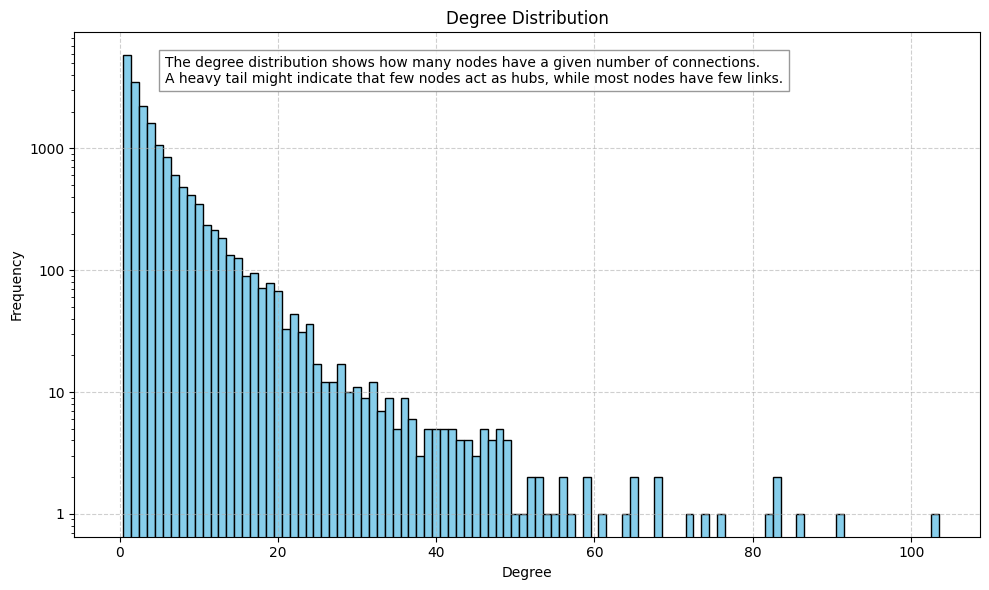

In [ ]:
# Extract degrees of all nodes
degrees = [deg for node, deg in G.degree()]
max_degree = max(degrees) if degrees else 0

plt.figure(figsize=(10, 6))
# Plot a histogram with bins for each degree value
plt.hist(degrees, bins=range(0, max_degree + 2), align='left', color='skyblue', edgecolor='black')
plt.title('Degree Distribution')
plt.xlabel('Degree')
plt.ylabel('Frequency')
plt.grid(True, linestyle='--', alpha=0.6)
plt.yscale('log')  # Logarithmic scale for better visibility
plt.gca().yaxis.set_major_formatter(ScalarFormatter())
plt.tight_layout()
plt.text(0.1, 0.9, 
         "The degree distribution shows how many nodes have a given number of connections.\n"
         "A heavy tail might indicate that few nodes act as hubs, while most nodes have few links.",
         transform=plt.gca().transAxes,
         bbox=dict(facecolor='white', alpha=0.8, edgecolor='gray'))
plt.show()

### Technical Explanation

**Graph Construction:**  
   We instantiate a NetworkX `Graph` (`G`) and iterate over `network_df` rows. For each row, we add an undirected edge between `gmap_id_from` and `gmap_id_to`, skipping any self-loops. NetworkX automatically manages duplicate edges.

**Basic Metrics & Degree Distribution:**  
   - We compute the total **number of nodes** and **edges** in the resulting graph.  
   - We then collect each node’s degree (i.e., how many edges it has) into a list and plot a **histogram** of these degrees.  
   - The y-axis is set to a **logarithmic scale** to highlight the spread in node connectivity.

**Network Summary:**  
  The graph has **18,609 nodes** (unique businesses) and **40,829 edges** (connections via co-reviews).
  
**Degree Distribution Plot:**  
  Most nodes have relatively few connections, while a smaller number of “hub” nodes have many, creating a **heavy-tailed** distribution. This pattern indicates that a handful of businesses are reviewed alongside many others, whereas most are only co-reviewed with a few.

### Finally, visualize the entire graph and describe what you observe. Use the default layout of `networkx` draw function.

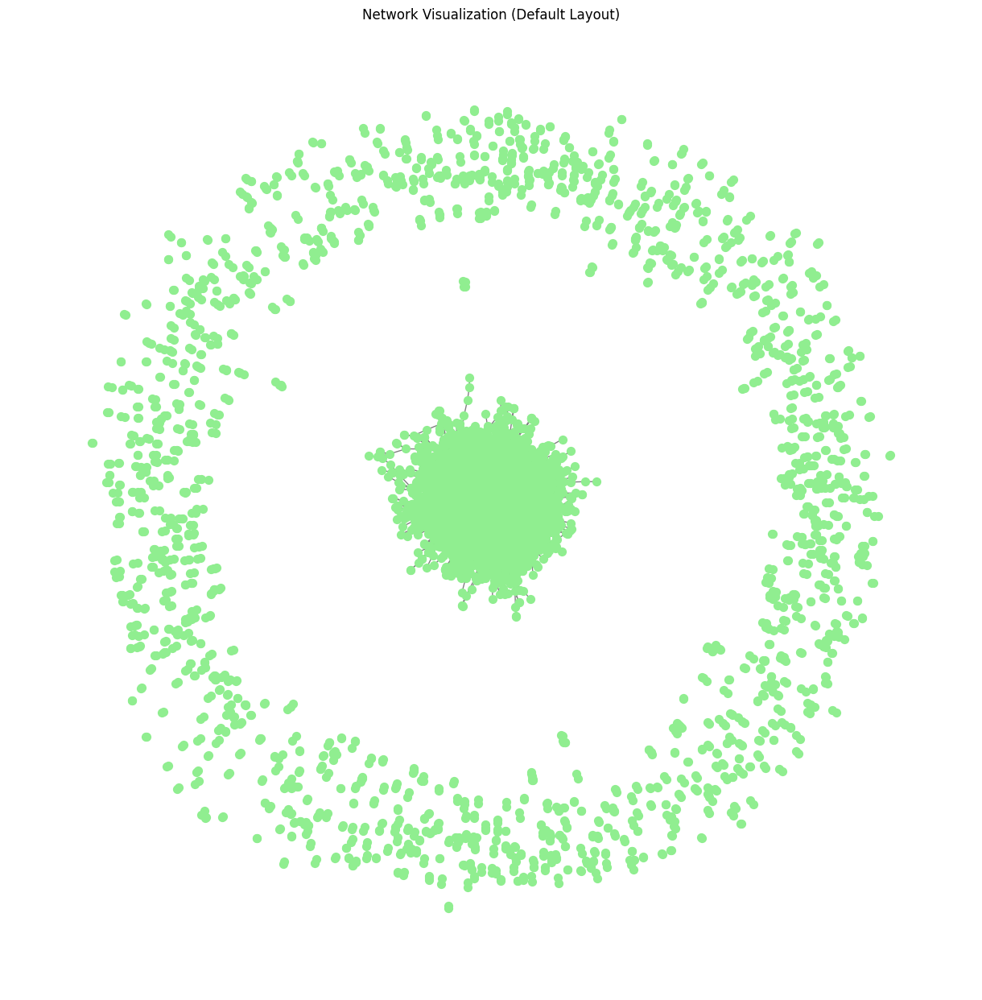

In [72]:
plt.figure(figsize=(12, 12))
nx.draw(G, node_size=50, font_size=8, edge_color='gray', node_color='lightgreen')
plt.title("Network Visualization (Default Layout)")
plt.show()

## Q4. Network Community Analysis

- We want to focus on buisnesses with many reviews. Keep only the nodes that have at least 15 edges. Afterward, remove nodes that are not connected to the central part of the network, i.e. the largest connected component.  

You can use the following code to help:  
```
largest_cc = max(nx.connected_components(subgraph), key=len)  
main_component = subgraph.subgraph(largest_cc)  
```

- Next, run the **Louvain algorithm** to divide the buisnesses in the main connected component into communities. Plot the buisnesses colored by their coomunity and describe the results in detail.

- Finally, we want to know whether communities reflect different categories.
— For each community compute the fraction of buisnesses form this community in each of the 30 top cateories from Q1, plus a 31st cateorgy called 'other' for all buisnesses in a different category
- Plot a heatmap showing the community-by-category fractions.
Do you see a relationship between the communities and categories? derive a staitstical test testing the null hypothesis of no such relationship, and report your test results.

### Focus on buisnesses with many reviews. Keep only the nodes that have at least 15 edges. Afterward, remove nodes that are not connected to the central part of the network, i.e. the largest connected component.  

In [78]:
import networkx as nx
import pandas as pd
import matplotlib.pyplot as plt

# Build the full undirected graph from network_df (removing self-loops)
G_full = nx.Graph()
for _, row in network_df.iterrows():
    u = row['gmap_id_from']
    v = row['gmap_id_to']
    if u != v:  # remove self-loops
        G_full.add_edge(u, v)

# Filter nodes that have at least 15 edges (degree >= 15)
nodes_high_degree = [node for node, degree in G_full.degree() if degree >= 15]
G_filtered = G_full.subgraph(nodes_high_degree).copy()

print("After filtering nodes with degree >= 15:")
print("Number of nodes:", G_filtered.number_of_nodes())
print("Number of edges:", G_filtered.number_of_edges())

# Remove nodes not in the largest connected component
largest_cc = max(nx.connected_components(G_filtered), key=len)
main_component = G_filtered.subgraph(largest_cc).copy()

print("\nAfter keeping only the largest connected component:")
print("Number of nodes:", main_component.number_of_nodes())
print("Number of edges:", main_component.number_of_edges())


After filtering nodes with degree >= 15:
Number of nodes: 885
Number of edges: 3000

After keeping only the largest connected component:
Number of nodes: 881
Number of edges: 3000


### Run the **Louvain algorithm** to divide the buisnesses in the main connected component into communities. Plot the buisnesses colored by their coomunity and describe the results in detail.


Louvain Community Detection:
Modularity: 0.5668800555555554


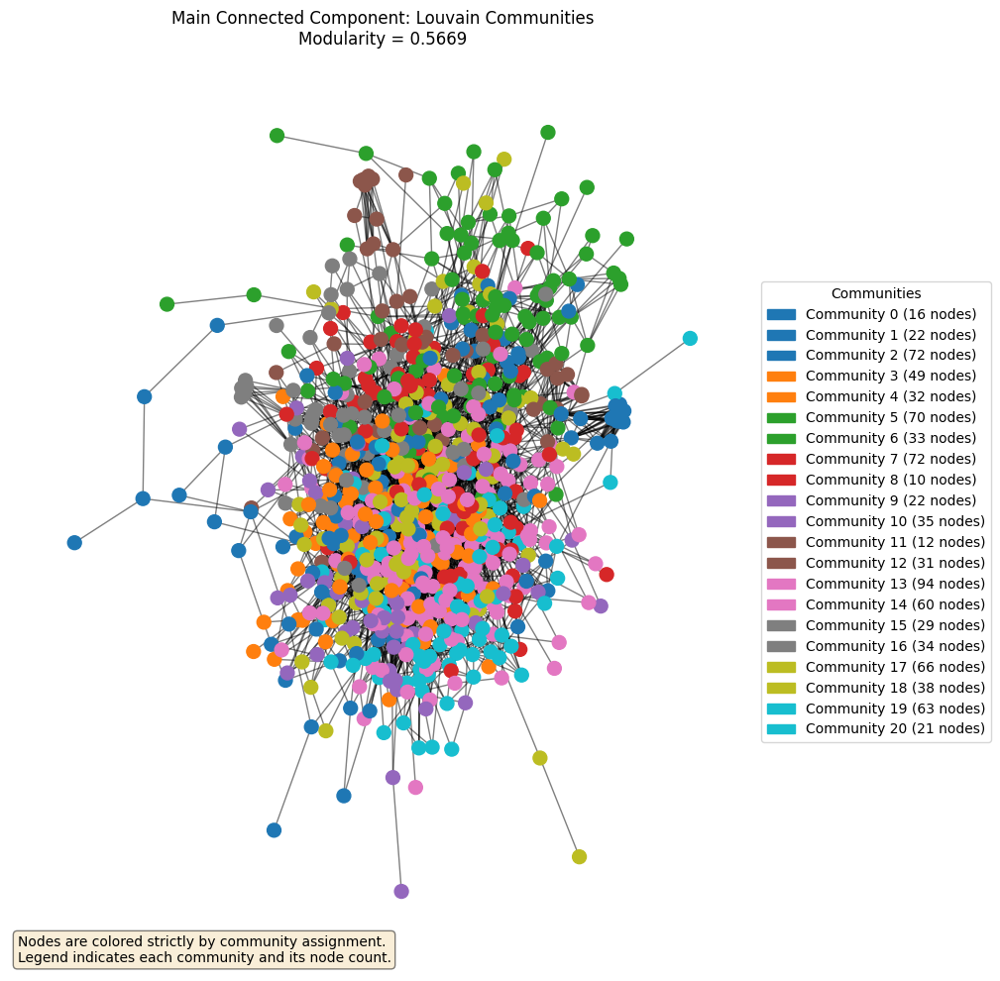

In [79]:
import community.community_louvain as community_louvain # Ensure the package "python-louvain" is installed
import matplotlib.patches as mpatches

# Apply the Louvain algorithm to the main connected component
partition = community_louvain.best_partition(main_component)
modularity_value = community_louvain.modularity(partition, main_component)

print("\nLouvain Community Detection:")
print("Modularity:", modularity_value)

# Compute counts per community
community_counts = {}
for node, comm in partition.items():
    community_counts.setdefault(comm, 0)
    community_counts[comm] += 1

# Determine unique communities for color mapping
communities = sorted(set(partition.values()))

# Prepare color mapping: assign each node a color based on its community
colors = [plt.cm.tab10(float(partition[node]) / len(communities)) for node in main_component.nodes()]

# Compute a spring layout for visualization
pos = nx.spring_layout(main_component, seed=42)

# Plot the network without node labels
plt.figure(figsize=(12, 10))
nx.draw_networkx_edges(main_component, pos, alpha=0.5, width=1)
nx.draw_networkx_nodes(main_component, pos, node_color=colors, node_size=100)

# Add an annotation text on the plot (positioned inside the axis, not covering graph nodes)
plt.text(0.01, 0.01, 
         "Nodes are colored strictly by community assignment.\nLegend indicates each community and its node count.",
         transform=plt.gca().transAxes, fontsize=10, bbox=dict(boxstyle='round', facecolor='wheat', alpha=0.5))

plt.title("Main Connected Component: Louvain Communities\nModularity = {:.4f}".format(modularity_value))
plt.axis('off')

# Create legend patches (position the legend outside of the plot area)
patches = []
for comm in communities:
    count = community_counts[comm]
    color_val = plt.cm.tab10(float(comm) / len(communities))
    patches.append(mpatches.Patch(color=color_val, label=f"Community {comm} ({count} nodes)"))

plt.legend(handles=patches, loc="center left", bbox_to_anchor=(1, 0.5), fontsize=10, title="Communities")

plt.tight_layout(rect=[0, 0, 0.85, 1])  # Adjust the layout to make room for the legend
plt.show()


### Finally, we want to know whether communities reflect different categories.

### For each community compute the fraction of buisnesses form this community in each of the 30 top cateories from Q1, plus a 31st cateorgy called 'other' for all buisnesses in a different category

In [80]:
# Start with the provided line:
category_counts = meta_df['category'].value_counts().head(30).sort_values()

# --- Prepare the meta-data for nodes in the main component ---
meta_unique = meta_df.drop_duplicates(subset='gmap_id')
meta_main = meta_unique[meta_unique['gmap_id'].isin(main_component.nodes())].copy()
meta_main['community'] = meta_main['gmap_id'].map(partition)

# --- Group categories: use top 30; all others become "other" ---
top30_categories = list(category_counts.index)
meta_main['category_group'] = meta_main['category'].apply(lambda x: x if x in top30_categories else 'other')

# --- Build the contingency table and reindex to ensure all 31 categories are present ---
all_categories = top30_categories + ['other']
community_category_counts = meta_main.groupby(['community', 'category_group']).size().unstack(fill_value=0)
community_category_counts = community_category_counts.reindex(columns=all_categories, fill_value=0)

# Compute fractions per community for the heatmap
community_category_fraction = community_category_counts.div(community_category_counts.sum(axis=1), axis=0)

### Plot a heatmap showing the community-by-category fractions.

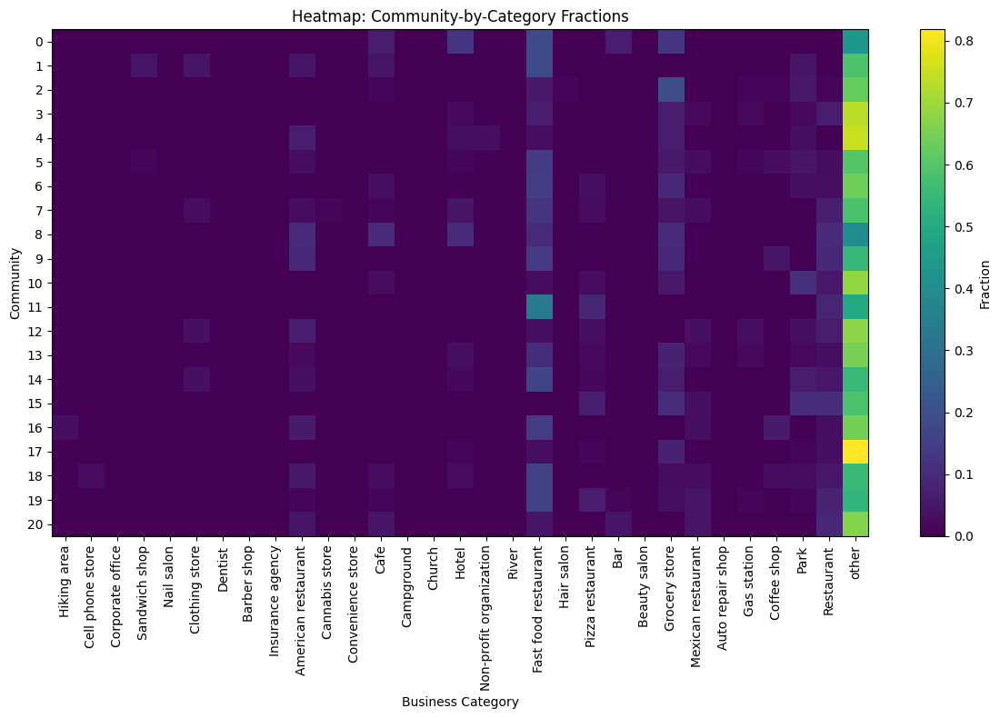

In [81]:
# --- Plot the heatmap ---
plt.figure(figsize=(12, 8))
im = plt.imshow(community_category_fraction, aspect='auto', cmap='viridis')
plt.colorbar(im, label='Fraction')
plt.xticks(ticks=range(len(community_category_fraction.columns)), 
           labels=community_category_fraction.columns, rotation=90)
plt.yticks(ticks=range(len(community_category_fraction.index)), 
           labels=community_category_fraction.index)
plt.xlabel('Business Category')
plt.ylabel('Community')
plt.title('Heatmap: Community-by-Category Fractions')
plt.tight_layout()
plt.show()

### Derive a staitstical test testing the null hypothesis of no such relationship, and report your test results.

In [82]:
# --- Remove columns with zero total counts before performing the chi-square test ---
nonzero_cols = community_category_counts.columns[community_category_counts.sum(axis=0) != 0]
contingency_table = community_category_counts[nonzero_cols]

# --- Statistical Test: Chi-square test of independence ---
from scipy.stats import chi2_contingency
chi2, p_value, dof, expected = chi2_contingency(contingency_table)
print("Chi-square test results:")
print("Chi-square statistic:", chi2)
print("Degrees of freedom:", dof)
print("p-value:", p_value)

# --- Interpret the result using a significance level alpha = 0.05 ---
alpha = 0.05
if p_value < alpha:
    print("\nResult: We reject the null hypothesis at alpha = 0.05.\nThere is a statistically significant association between the communities and business categories.")
else:
    print("\nResult: We don't reject the null hypothesis at alpha = 0.05.\nThere is no statistically significant association between the communities and business categories.")

Chi-square test results:
Chi-square statistic: 431.7409199462054
Degrees of freedom: 380
p-value: 0.034245389665449544

Result: We reject the null hypothesis at alpha = 0.05.
There is a statistically significant association between the communities and business categories.


## Q5. Geographic Community Analysis
 In this question we will explore whether there is any geographical significance to the communities that were formed.
-  Choose the **five largest communities**. For each one of them, calculate the average latitude and longitude $\text{Lon, Lat}$ of all locations within it.

- Then, compute the Empirical Cumulative Distribution Function (**ECDF**) of the distances from each location to the center of buisnesses in this community. Plot in addition the **ECDF** of the distance to the center for all locations in the entire dataset.
What do the results show? Do you observe geographical clustering of the communities?  

- Next, plot the points of the buisnesses in the largest five communities on a map using the `folium` library, with each community displayed in a different color. What do you observe? Explain in a couple of sentences the results and why they might occur.

### Choose the **five largest communities**. For each one of them, calculate the average latitude and longitude of all locations within it.

In [83]:
# Compute the five largest communities (community id and number of nodes)
largest_five_communities = meta_main['community'].value_counts().nlargest(5)

# Convert the Series to a DataFrame
largest_five_df = largest_five_communities.reset_index()
largest_five_df.columns = ['community', 'num_nodes']

# Compute the average longitude and latitude for each of these top five communities
avg_coords = meta_main[meta_main['community'].isin(largest_five_df['community'])] \
    .groupby('community').agg({'longitude': 'mean', 'latitude': 'mean'}).reset_index()

# Merge the counts with the average coordinates into one DataFrame
df_summary_Q5 = pd.merge(largest_five_df, avg_coords, on='community')

# Print the summary DataFrame
print("\nSummary of the Five Largest Communities:")
df_summary_Q5


Summary of the Five Largest Communities:


,community,num_nodes,longitude,latitude
0,13,94,-122.930073,45.031824
1,7,72,-122.904775,45.220555
2,2,72,-122.899881,44.641473
3,5,70,-123.101915,44.100459
4,17,66,-122.759289,45.093018


### Then, compute the Empirical Cumulative Distribution Function (**ECDF**) of the distances from each location to the center of buisnesses in this community. Plot in addition the **ECDF** of the distance to the center for all locations in the entire dataset. What do the results show? Do you observe geographical clustering of the communities?  

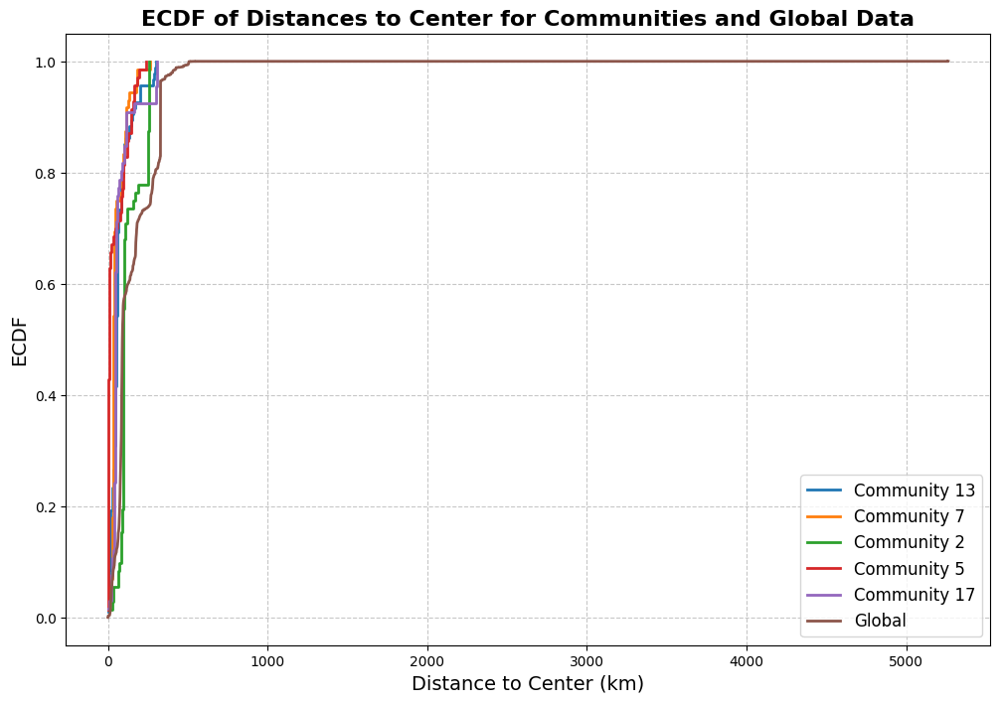

In [84]:
import numpy as np
import matplotlib.pyplot as plt
from geopy.distance import geodesic

# Ensure the default style uses a white background
plt.style.use('default')
plt.rcParams['axes.facecolor'] = 'white'

# --- Compute ECDF for the five largest communities ---
# df_summary is assumed to contain: community, num_nodes, longitude, latitude
# meta_main contains the meta-data for businesses in the main component, with a 'community' column
ecdf_data = {}

for idx, row in df_summary_Q5.iterrows():
    # Ensure the community id is an integer
    comm = int(row['community'])
    center_lat = row['latitude']
    center_lon = row['longitude']
    
    # Filter for businesses in this community
    subset = meta_main[meta_main['community'] == comm]
    # Compute the distance (in km) from each business to the community center
    distances = subset.apply(lambda r: geodesic((r['latitude'], r['longitude']), (center_lat, center_lon)).km, axis=1)
    distances = distances.sort_values().values
    n = len(distances)
    ecdf_values = np.arange(1, n + 1) / n
    ecdf_data[f'Community {comm}'] = (distances, ecdf_values)

# --- Compute ECDF for all unique businesses (global) ---
meta_unique = meta_df.drop_duplicates(subset='gmap_id')
# Compute the global center (average latitude and longitude)
global_center = (meta_unique['latitude'].mean(), meta_unique['longitude'].mean())
global_distances = meta_unique.apply(lambda r: geodesic((r['latitude'], r['longitude']), global_center).km, axis=1)
global_distances = global_distances.sort_values().values
n_global = len(global_distances)
global_ecdf = np.arange(1, n_global + 1) / n_global
ecdf_data['Global'] = (global_distances, global_ecdf)

# --- Plot the ECDF curves ---
plt.figure(figsize=(12, 8), facecolor='white')
for label, (x, y) in ecdf_data.items():
    plt.step(x, y, where='post', label=label, linewidth=2)

plt.xlabel('Distance to Center (km)', fontsize=14)
plt.ylabel('ECDF', fontsize=14)
plt.title('ECDF of Distances to Center for Communities and Global Data', fontsize=16, fontweight='bold')
plt.legend(fontsize=12)
plt.grid(True, linestyle='--', alpha=0.7)
plt.show()
